# Import Libraries

In [1]:
# import contractions library.
!pip install contractions missingno wordcloud


[notice] A new release of pip is available: 24.0 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
# Import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import warnings
warnings.filterwarnings(action='ignore')

# Import NLTK and download required resources
import nltk
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize, sent_tokenize 
from nltk.stem import LancasterStemmer, WordNetLemmatizer

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

# Import other libraries
import re
import string
import unicodedata
import contractions
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import wordcloud
from wordcloud import STOPWORDS, WordCloud
import pandas as pd
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import (
    recall_score,
    accuracy_score,
    confusion_matrix,
    classification_report,
    f1_score,
    precision_score,
    precision_recall_fscore_support
)

# Set options for displaying data
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 200)


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\naman\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\naman\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\naman\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# Read the data

In [3]:
df = pd.read_csv('Tweets.csv')
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,5.703079e+17,positive,1.0000,NaN,NaN,United,NaN,rdowning76,NaN,0,@united thanks,NaN,02/24/2015 11:42:48,usa,NaN
1,5.703078e+17,positive,1.0000,NaN,NaN,United,NaN,CoreyAStewart,NaN,0,@united Thanks for taking care of that MR!! Ha...,NaN,02/24/2015 11:42:41,"Richmond, VA",Eastern Time (US & Canada)
2,5.703071e+17,negative,1.0000,Cancelled Flight,0.703,United,NaN,CoralReefer420,NaN,0,@united still no refund or word via DM. Please...,NaN,02/24/2015 11:39:45,"Bay Area, California",Alaska
3,5.703070e+17,negative,1.0000,Late Flight,1.000,United,NaN,lsalazarll,NaN,0,@united Delayed due to lack of crew and now de...,NaN,02/24/2015 11:39:25,NaN,Mountain Time (US & Canada)
4,5.703067e+17,positive,0.3441,NaN,0.000,United,NaN,rombaa,NaN,0,@united thanks -- we filled it out. How's our ...,NaN,02/24/2015 11:38:15,NaN,NaN


In [4]:
texts = [[word.lower() for word in text.split()] for text in df]

In [5]:
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,5.703079e+17,positive,1.0000,NaN,NaN,United,NaN,rdowning76,NaN,0,@united thanks,NaN,02/24/2015 11:42:48,usa,NaN
1,5.703078e+17,positive,1.0000,NaN,NaN,United,NaN,CoreyAStewart,NaN,0,@united Thanks for taking care of that MR!! Ha...,NaN,02/24/2015 11:42:41,"Richmond, VA",Eastern Time (US & Canada)
2,5.703071e+17,negative,1.0000,Cancelled Flight,0.703,United,NaN,CoralReefer420,NaN,0,@united still no refund or word via DM. Please...,NaN,02/24/2015 11:39:45,"Bay Area, California",Alaska
3,5.703070e+17,negative,1.0000,Late Flight,1.000,United,NaN,lsalazarll,NaN,0,@united Delayed due to lack of crew and now de...,NaN,02/24/2015 11:39:25,NaN,Mountain Time (US & Canada)
4,5.703067e+17,positive,0.3441,NaN,0.000,United,NaN,rombaa,NaN,0,@united thanks -- we filled it out. How's our ...,NaN,02/24/2015 11:38:15,NaN,NaN


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3822 entries, 0 to 3821
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   tweet_id                      3822 non-null   float64
 1   airline_sentiment             3822 non-null   object 
 2   airline_sentiment_confidence  3822 non-null   float64
 3   negativereason                2633 non-null   object 
 4   negativereason_confidence     3000 non-null   float64
 5   airline                       3822 non-null   object 
 6   airline_sentiment_gold        8 non-null      object 
 7   name                          3822 non-null   object 
 8   negativereason_gold           7 non-null      object 
 9   retweet_count                 3822 non-null   int64  
 10  text                          3822 non-null   object 
 11  tweet_coord                   319 non-null    object 
 12  tweet_created                 3822 non-null   object 
 13  twe

# Observations:
There are 15 columns in the dataset. Half of the columns have null values. Considering both dependent and independent variables not having any null values, we will not do any null value processing. Most columns in the dataset are of object type. airline_sentiment is our dependent / target variable. text column is our independent variable that we will use for analysis. All other columns will be dropped at a later stage.

In [7]:
df.isnull().sum()

tweet_id                           0
airline_sentiment                  0
airline_sentiment_confidence       0
negativereason                  1189
negativereason_confidence        822
airline                            0
airline_sentiment_gold          3814
name                               0
negativereason_gold             3815
retweet_count                      0
text                               0
tweet_coord                     3503
tweet_created                      0
tweet_location                  1189
user_timezone                   1295
dtype: int64

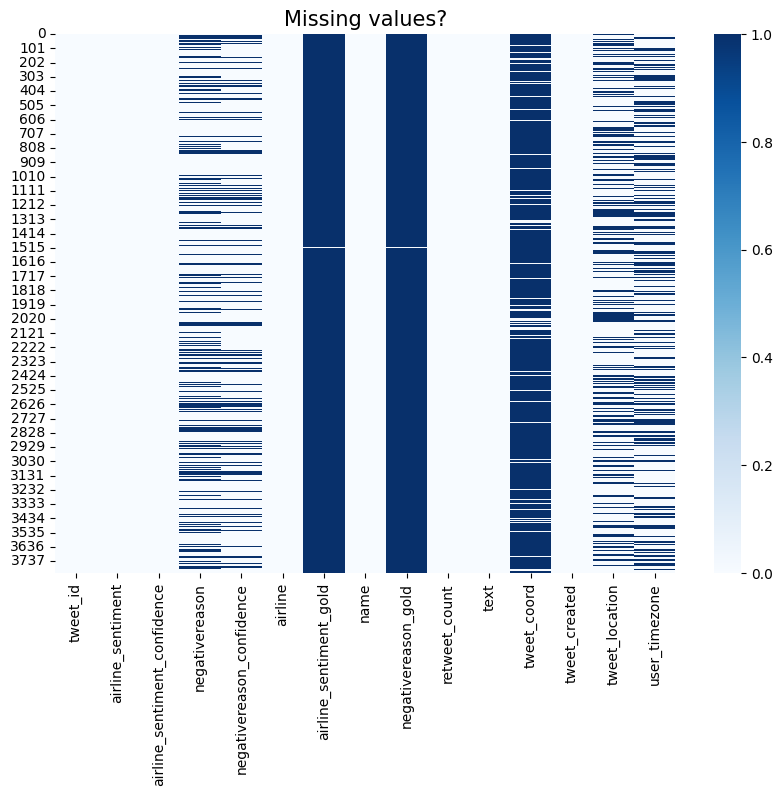

In [8]:
#Visualization of missing value using heatmap
plt.figure(figsize=(10,7))
sns.heatmap(df.isnull(), cmap = "Blues")                       
plt.title("Missing values?", fontsize = 15)
plt.show()

In [9]:
print("Percentage null or na values in df")
((df.isnull() | df.isna()).sum() * 100 / df.index.size).round(2)

Percentage null or na values in df


tweet_id                         0.00
airline_sentiment                0.00
airline_sentiment_confidence     0.00
negativereason                  31.11
negativereason_confidence       21.51
airline                          0.00
airline_sentiment_gold          99.79
name                             0.00
negativereason_gold             99.82
retweet_count                    0.00
text                             0.00
tweet_coord                     91.65
tweet_created                    0.00
tweet_location                  31.11
user_timezone                   33.88
dtype: float64

#### airline_sentiment_gold, negativereason_gold have more than 99% missing data And tweet_coord have nearly 93% missing data. It will be better to delete these columns as they will not provide any constructive information

In [10]:
df.drop(["tweet_coord", "airline_sentiment_gold", "negativereason_gold"], axis=1, inplace=True)

In [11]:
df.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone
0,5.703079e+17,positive,1.0000,NaN,NaN,United,rdowning76,0,@united thanks,02/24/2015 11:42:48,usa,NaN
1,5.703078e+17,positive,1.0000,NaN,NaN,United,CoreyAStewart,0,@united Thanks for taking care of that MR!! Ha...,02/24/2015 11:42:41,"Richmond, VA",Eastern Time (US & Canada)
2,5.703071e+17,negative,1.0000,Cancelled Flight,0.703,United,CoralReefer420,0,@united still no refund or word via DM. Please...,02/24/2015 11:39:45,"Bay Area, California",Alaska
3,5.703070e+17,negative,1.0000,Late Flight,1.000,United,lsalazarll,0,@united Delayed due to lack of crew and now de...,02/24/2015 11:39:25,NaN,Mountain Time (US & Canada)
4,5.703067e+17,positive,0.3441,NaN,0.000,United,rombaa,0,@united thanks -- we filled it out. How's our ...,02/24/2015 11:38:15,NaN,NaN


In [12]:
freq = df.groupby("negativereason").size()

In [13]:
df.duplicated().sum()

np.int64(0)

In [14]:
# Dropping duplicates
df.drop_duplicates(inplace = True)

In [15]:
df.duplicated().sum()

np.int64(0)

In [16]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
tweet_id,3822.0,5.690949e+17,7.515777e+14,5.675915e+17,5.684908e+17,5.692193e+17,5.697103e+17,5.703079e+17
airline_sentiment_confidence,3822.0,9.008777e-01,1.628267e-01,3.350000e-01,6.931750e-01,1.000000e+00,1.000000e+00,1.000000e+00
negativereason_confidence,3000.0,6.272854e-01,3.247844e-01,0.000000e+00,3.572500e-01,6.680500e-01,1.000000e+00,1.000000e+00
retweet_count,3822.0,1.101518e-01,3.684162e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,7.000000e+00


# EDA

In [17]:
df.nunique()

tweet_id                        3822
airline_sentiment                  3
airline_sentiment_confidence     556
negativereason                    10
negativereason_confidence        826
airline                            1
name                            1989
retweet_count                      7
text                            3805
tweet_created                   3807
tweet_location                   970
user_timezone                     59
dtype: int64

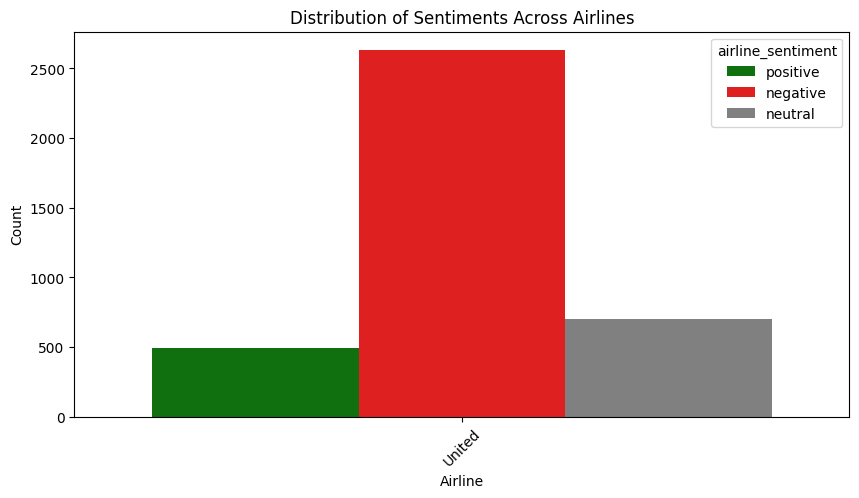

In [18]:
plt.figure(figsize=(10,5))
sns.countplot(data=df, x="airline", hue="airline_sentiment", 
              palette={"positive": "green", "negative": "red", "neutral": "gray"})
plt.title("Distribution of Sentiments Across Airlines")
plt.xlabel("Airline")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

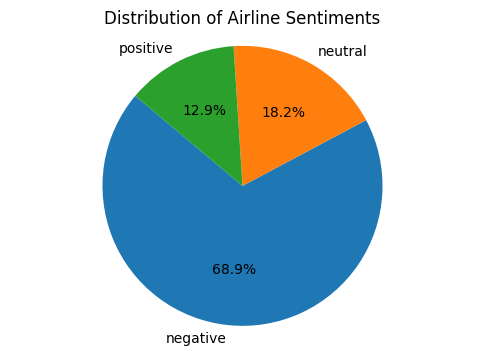

In [19]:
# Visualize the distribution of airline sentiments using a pie chart
sentiment_counts = df['airline_sentiment'].value_counts()
plt.figure(figsize=(6, 4))
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Airline Sentiments')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

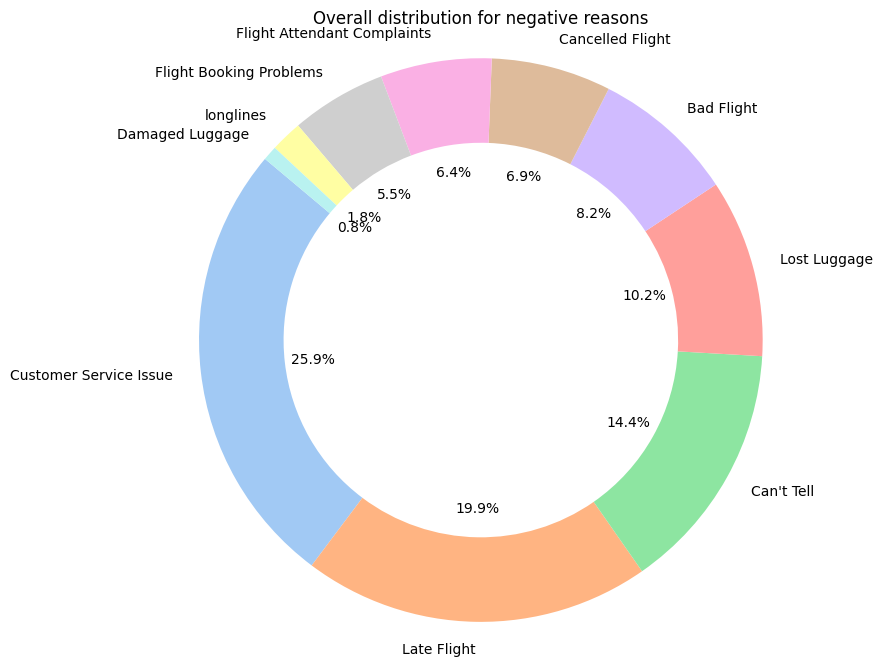

In [20]:
# Calculate the value counts for each negative reason
value_counts = df['negativereason'].value_counts()

# Create a donut-like pie chart using matplotlib and seaborn
plt.figure(figsize=(8, 8))
labels = value_counts.index
values = value_counts.values
colors = sns.color_palette('pastel')[0:len(labels)]  # Use pastel colors for the chart
plt.pie(values, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140, wedgeprops=dict(width=0.3))
plt.title('Overall distribution for negative reasons')
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is drawn as a circle.
plt.show()

### Data clearing and preprocessing of Text

In [21]:
# Select only the necessary columns for sentiment analysis
df = df[['airline_sentiment', 'text']].copy()

In [22]:
df

,airline_sentiment,text
0,positive,@united thanks
1,positive,@united Thanks for taking care of that MR!! Ha...
2,negative,@united still no refund or word via DM. Please...
3,negative,@united Delayed due to lack of crew and now de...
4,positive,@united thanks -- we filled it out. How's our ...
...,...,...
3817,negative,"@united, link to current status of flights/air..."
3818,negative,@united I like delays less than you because I'...
3819,negative,@united and don't hope for me having a nicer f...
3820,negative,@united the we got into the gate at IAH on tim...


In [23]:
X = df["text"]
y = df["airline_sentiment"]

In [24]:
X

0                                          @united thanks
1       @united Thanks for taking care of that MR!! Ha...
2       @united still no refund or word via DM. Please...
3       @united Delayed due to lack of crew and now de...
4       @united thanks -- we filled it out. How's our ...
                              ...                        
3817    @united, link to current status of flights/air...
3818    @united I like delays less than you because I'...
3819    @united and don't hope for me having a nicer f...
3820    @united the we got into the gate at IAH on tim...
3821    @united yes. We waited in line for almost an h...
Name: text, Length: 3822, dtype: object

In [25]:
y

0       positive
1       positive
2       negative
3       negative
4       positive
          ...   
3817    negative
3818    negative
3819    negative
3820    negative
3821    negative
Name: airline_sentiment, Length: 3822, dtype: object

# Model Training

In [26]:
# Train Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [27]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(3057,) (765,) (3057,) (765,)


In [28]:
# Create a TF-IDF vectorizer with English stop words removal for text feature extraction.
tfidf = TfidfVectorizer(stop_words="english")

In [29]:
tfidf.fit(X_train)

TfidfVectorizer(stop_words='english')

In [30]:
print(tfidf.get_feature_names_out())

['00' '000' '0011' ... 'œthank' 'œâ' 'ƒðÿ']


In [31]:
print(tfidf.vocabulary_)

{'united': 5344, 'dmed': 1792, 'thank': 4964, 'protected': 3990, 'flight': 2203, 'gate': 2355, 'agent': 610, 'kerry': 2945, 'las': 3012, 'did': 1716, 'excellent': 2024, 'job': 2901, 'getting': 2371, 'destination': 1706, 'today': 5042, 'thanks': 4969, 'sorry': 4663, 'cold': 1337, 'chicago': 1248, 'don': 1809, 'means': 3258, 'takes': 4913, '45': 309, 'minutes': 3333, 'priority': 3944, 'bag': 888, 'carousel': 1164, 'send': 4478, 'note': 3518, 'revenue': 4287, 'management': 3223, 'team': 4932, 'ask': 780, 'open': 3606, 'bf': 963, 'gf': 2372, 'seats': 4453, '919': 490, 'hour': 2636, 'delay': 1656, 'print': 3942, 'piece': 3798, 'paper': 3709, 'just': 2926, 'tried': 5116, 'log': 3128, 'told': 5050, 'mail': 3199, 'currently': 1570, 'available': 838, 'delayed': 1657, 'response': 4262, 'ua': 5174, '381': 262, 'san': 4388, 'fran': 2286, 'held': 2544, 'tarmac': 4922, 'lost': 3151, 'bags': 892, 'hi': 2562, 'yes': 5687, 'need': 3451, 'free': 2296, 'hotel': 2630, 'stay': 4749, 'honalulu': 2597, 'dela

In [32]:
count_vect = CountVectorizer(stop_words="english")
neg_matrix = count_vect.fit_transform(df[df["airline_sentiment"]=="negative"]["text"])
freqs = zip(count_vect.get_feature_names_out(), neg_matrix.sum(axis=0).tolist()[0])
# Sort from largest to smallest
print(sorted(freqs, key=lambda x: -x[1])[:100])

[('united', 2848), ('flight', 788), ('service', 227), ('time', 193), ('customer', 181), ('just', 181), ('delayed', 179), ('bag', 174), ('cancelled', 172), ('plane', 171), ('gate', 147), ('amp', 142), ('hours', 141), ('http', 137), ('late', 123), ('help', 122), ('don', 117), ('hour', 117), ('flights', 115), ('airline', 103), ('like', 101), ('thanks', 99), ('waiting', 99), ('delay', 96), ('ve', 91), ('bags', 90), ('lost', 82), ('worst', 81), ('flightled', 80), ('airport', 78), ('people', 78), ('did', 75), ('day', 74), ('wait', 74), ('need', 73), ('luggage', 71), ('really', 70), ('check', 69), ('seat', 69), ('fly', 67), ('going', 67), ('crew', 66), ('make', 66), ('got', 65), ('baggage', 64), ('agent', 63), ('told', 63), ('trying', 62), ('seats', 61), ('ewr', 60), ('days', 59), ('staff', 59), ('know', 58), ('minutes', 58), ('ord', 57), ('ticket', 57), ('today', 56), ('yes', 56), ('let', 55), ('want', 55), ('min', 54), ('miss', 54), ('phone', 54), ('connection', 53), ('way', 53), ('flying',

### Wordcloud for Positive Reasons

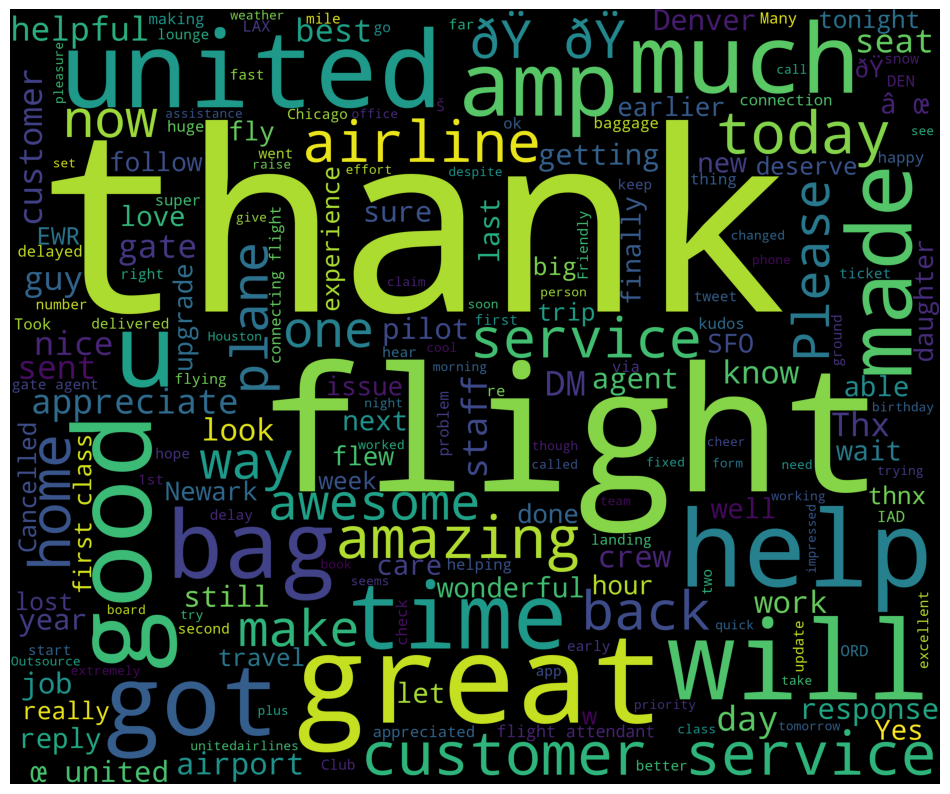

In [33]:
new_df = df[df["airline_sentiment"] == "positive"]
words = " ".join(new_df["text"])
cleaned_word = " ".join([word for word in words.split() if "http" not in word and not word.startswith("@") and word != "RT"])
wordcloud = WordCloud(stopwords = STOPWORDS,
                     background_color = "black", width = 3000, height = 2500).generate(cleaned_word)
plt.figure(figsize = (12, 12))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

### Wordcloud for Negative Reasons

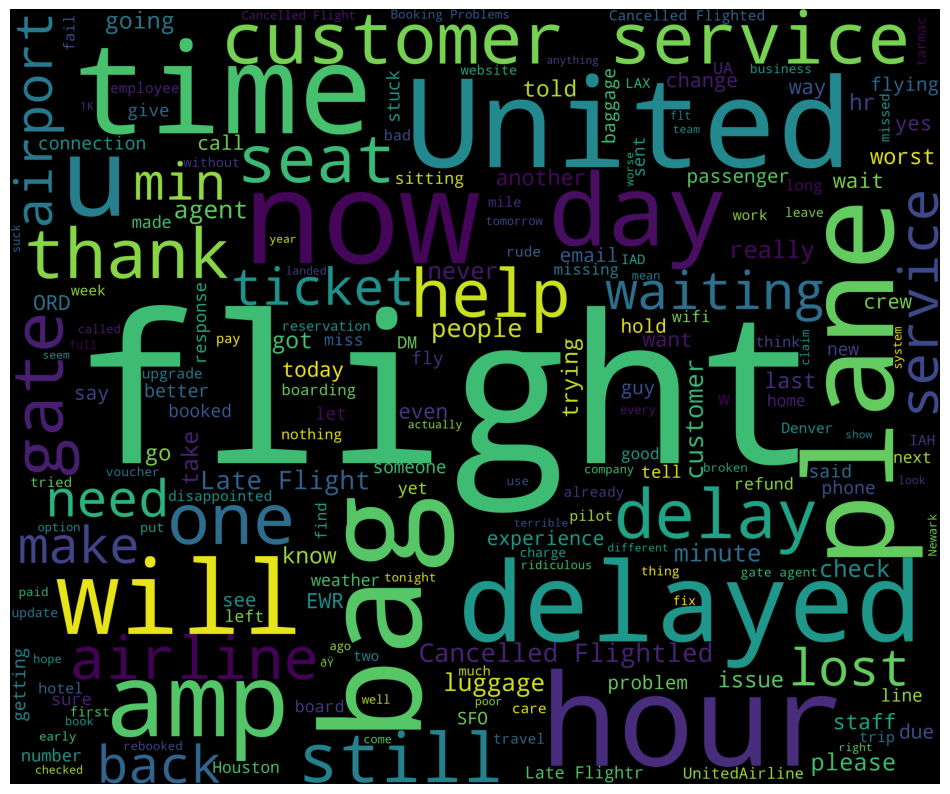

In [34]:
new_df = df[df["airline_sentiment"] == "negative"]
words = " ".join(new_df["text"])
cleaned_word = " ".join([word for word in words.split() if "http" not in word and not word.startswith("@") and word != "RT"])
wordcloud = WordCloud(stopwords = STOPWORDS,
                     background_color = "black", width = 3000, height = 2500).generate(cleaned_word)
plt.figure(figsize = (12, 12))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

### Data Scaling

In [35]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

le.fit(df["airline_sentiment"])
df["airline_sentiment_encoded"] = le.transform(df["airline_sentiment"])
df.head()

,airline_sentiment,text,airline_sentiment_encoded
0,positive,@united thanks,2
1,positive,@united Thanks for taking care of that MR!! Ha...,2
2,negative,@united still no refund or word via DM. Please...,0
3,negative,@united Delayed due to lack of crew and now de...,0
4,positive,@united thanks -- we filled it out. How's our ...,2


In [36]:
def tweet_to_words(tweet):
    letters_only = re.sub("[^a-zA-Z]", " ", tweet)
    words = letters_only.lower().split()
    stops = set(stopwords.words("english"))
    meaningful_words = [w for w in words if not w in stops]
    return(" ".join( meaningful_words ))

In [37]:
nltk.download("stopwords")
df["clean_tweet"] = df["text"].apply(lambda x: tweet_to_words(x))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\naman\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3822 entries, 0 to 3821
Data columns (total 4 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   airline_sentiment          3822 non-null   object
 1   text                       3822 non-null   object
 2   airline_sentiment_encoded  3822 non-null   int64 
 3   clean_tweet                3822 non-null   object
dtypes: int64(1), object(3)
memory usage: 119.6+ KB


In [39]:
X = df["clean_tweet"]
y = df["airline_sentiment"]

In [40]:
print(X.shape, y.shape)

(3822,) (3822,)


In [41]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

In [42]:
vect = CountVectorizer()
vect.fit(X_train)

CountVectorizer()

In [43]:
X_train_dtm = vect.transform(X_train)
X_test_dtm = vect.transform(X_test)

### Tuning

In [44]:
vect_tunned = CountVectorizer(stop_words = "english", ngram_range = (1, 2), min_df = 0.1, max_df = 0.7, max_features = 100)
vect_tunned

CountVectorizer(max_df=0.7, max_features=100, min_df=0.1, ngram_range=(1, 2),
                stop_words='english')

### Model Building

In [45]:
from sklearn.svm import SVC
model = SVC(kernel = "linear", random_state = 10)
model.fit(X_train_dtm, y_train)
pred = model.predict(X_test_dtm)

In [46]:
print("Accuracy Score: ", accuracy_score(y_test, pred) * 100)

Accuracy Score:  71.86192468619247


In [47]:
print("Confusion Matrix\n\n", confusion_matrix(y_test, pred))

Confusion Matrix

 [[534  74  26]
 [ 91  82  15]
 [ 44  19  71]]


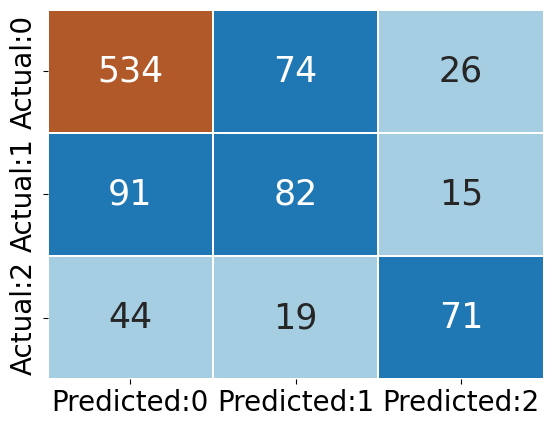

In [48]:
# Assuming that 'y_test' and 'pred' contain labels for a multi-class problem with three classes
conf_matrix = pd.DataFrame(data=confusion_matrix(y_test, pred), columns=['Predicted:0', 'Predicted:1', 'Predicted:2'], index=['Actual:0', 'Actual:1', 'Actual:2'])

# Plot the 3x3 confusion matrix
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Paired', cbar=False, linewidths=0.1, annot_kws={'size': 25})
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

In [49]:
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

    negative       0.80      0.84      0.82       634
     neutral       0.47      0.44      0.45       188
    positive       0.63      0.53      0.58       134

    accuracy                           0.72       956
   macro avg       0.63      0.60      0.62       956
weighted avg       0.71      0.72      0.71       956



In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from textblob import TextBlob
from datetime import datetime
from wordcloud import WordCloud, STOPWORDS
import warnings
warnings.filterwarnings('ignore')

In [51]:
# Cell 2: Load and Verify Data
# [Previous code remains the same for loading data]
df = pd.read_csv('Tweets.csv')
print("Dataset Shape:", df.shape)
print("\nFirst few rows of the dataset:")
df.head()

Dataset Shape: (3822, 15)

First few rows of the dataset:


,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,5.703079e+17,positive,1.0000,NaN,NaN,United,NaN,rdowning76,NaN,0,@united thanks,NaN,02/24/2015 11:42:48,usa,NaN
1,5.703078e+17,positive,1.0000,NaN,NaN,United,NaN,CoreyAStewart,NaN,0,@united Thanks for taking care of that MR!! Ha...,NaN,02/24/2015 11:42:41,"Richmond, VA",Eastern Time (US & Canada)
2,5.703071e+17,negative,1.0000,Cancelled Flight,0.703,United,NaN,CoralReefer420,NaN,0,@united still no refund or word via DM. Please...,NaN,02/24/2015 11:39:45,"Bay Area, California",Alaska
3,5.703070e+17,negative,1.0000,Late Flight,1.000,United,NaN,lsalazarll,NaN,0,@united Delayed due to lack of crew and now de...,NaN,02/24/2015 11:39:25,NaN,Mountain Time (US & Canada)
4,5.703067e+17,positive,0.3441,NaN,0.000,United,NaN,rombaa,NaN,0,@united thanks -- we filled it out. How's our ...,NaN,02/24/2015 11:38:15,NaN,NaN


In [52]:

def predict_sentiment(text, model, vectorizer):
    """Predicts the sentiment of a given text using the trained model and vectorizer."""
    try:
        cleaned_text = tweet_to_words(text)
        text_dtm = vectorizer.transform([cleaned_text])
        prediction = model.predict(text_dtm)[0]
        probability = np.max(model.predict_proba(text_dtm)) if hasattr(model, 'predict_proba') else None
        return prediction, probability
    except Exception as e:
        print(f"Error in prediction: {e}")
        return None, None

# Test the prediction function
test_tweets = [
    "@united Thanks for the great service!",
    "@united Flight delayed again... terrible experience",
    "@united Normal flight, nothing special"
]

print("Sentiment Predictions for Sample Tweets:")
for tweet in test_tweets:
    pred, conf = predict_sentiment(tweet, model, vect)
    print(f"\nTweet: {tweet}")
    print(f"Predicted Sentiment: {pred}")
    print(f"Confidence: {conf:.2f}" if conf is not None else "Confidence: Not Available")

Sentiment Predictions for Sample Tweets:

Tweet: @united Thanks for the great service!
Predicted Sentiment: positive
Confidence: Not Available

Tweet: @united Flight delayed again... terrible experience
Predicted Sentiment: negative
Confidence: Not Available

Tweet: @united Normal flight, nothing special
Predicted Sentiment: negative
Confidence: Not Available


<Figure size 1500x600 with 0 Axes>

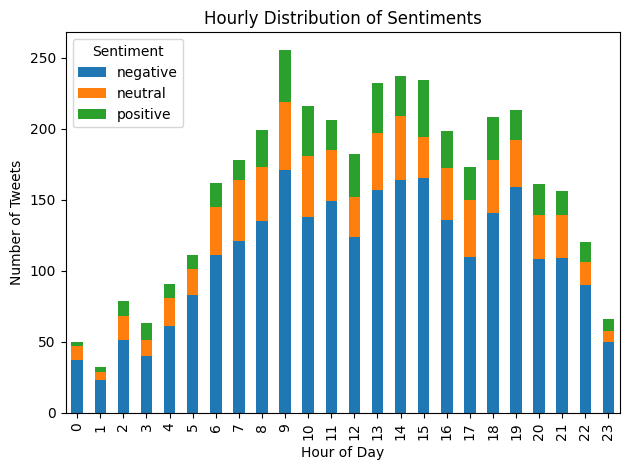

In [53]:
# Cell 4: Time-Based Sentiment Analysis
# Convert tweet_created to datetime
df['tweet_created'] = pd.to_datetime(df['tweet_created'])

# Create hourly sentiment distribution
hourly_sentiment = df.groupby([df['tweet_created'].dt.hour, 'airline_sentiment']).size().unstack()

# Plot hourly sentiment distribution
plt.figure(figsize=(15, 6))
hourly_sentiment.plot(kind='bar', stacked=True)
plt.title('Hourly Distribution of Sentiments')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Tweets')
plt.legend(title='Sentiment')
plt.tight_layout()
plt.show()

In [54]:
def calculate_sentiment_metrics(df):
    metrics = {
        'total_tweets': len(df),
        'sentiment_distribution': df['airline_sentiment'].value_counts().to_dict(),
        'sentiment_by_day': df.groupby(df['tweet_created'].dt.date)['airline_sentiment'].value_counts().unstack().fillna(0),
        'average_confidence': df['airline_sentiment_confidence'].mean()
    }
    return metrics

metrics = calculate_sentiment_metrics(df)
print("Sentiment Metrics Summary:")
for key, value in metrics.items():
    if key != 'sentiment_by_day':
        print(f"\n{key}:")
        print(value)

Sentiment Metrics Summary:

total_tweets:
3822

sentiment_distribution:
{'negative': 2633, 'neutral': 697, 'positive': 492}

average_confidence:
0.9008776818419676


In [55]:
# Cell 6: Interactive Sentiment Timeline
fig = go.Figure()

for sentiment in ['positive', 'negative', 'neutral']:
    daily_count = df[df['airline_sentiment'] == sentiment].groupby(
        df['tweet_created'].dt.date).size()
    
    fig.add_trace(go.Scatter(
        x=daily_count.index,
        y=daily_count.values,
        name=sentiment,
        mode='lines+markers'
    ))

fig.update_layout(
    title='Daily Sentiment Trends',
    xaxis_title='Date',
    yaxis_title='Number of Tweets',
    hovermode='x unified'
)
fig.show()

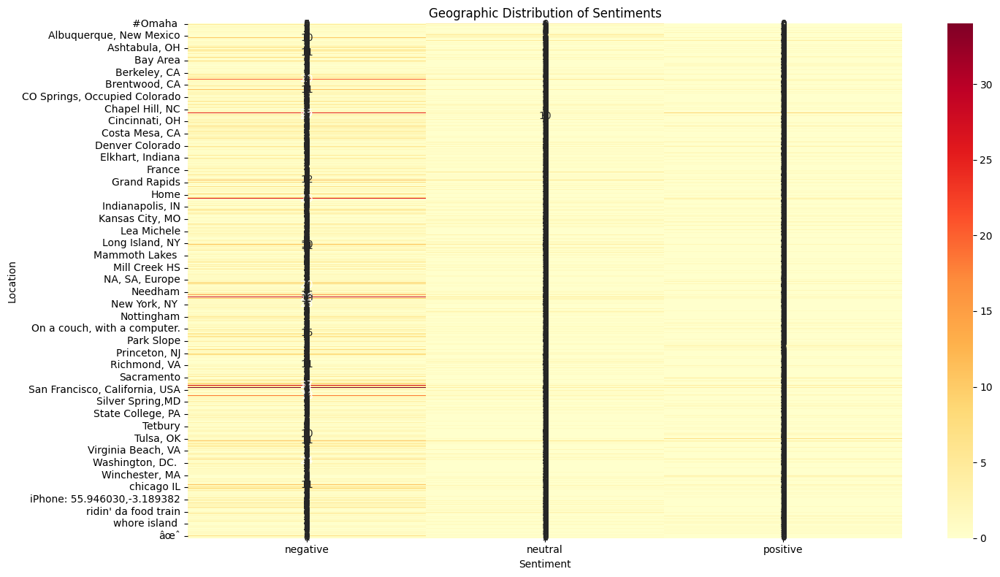

In [56]:
# Cell 8: Geographic Sentiment Analysis
df_geo = df[df['tweet_location'].notna()].copy()
location_sentiment = df_geo.groupby('tweet_location')['airline_sentiment'].value_counts().unstack(fill_value=0)

plt.figure(figsize=(15, 8))
sns.heatmap(location_sentiment, annot=True, fmt='g', cmap='YlOrRd')
plt.title('Geographic Distribution of Sentiments')
plt.xlabel('Sentiment')
plt.ylabel('Location')
plt.tight_layout()
plt.show()

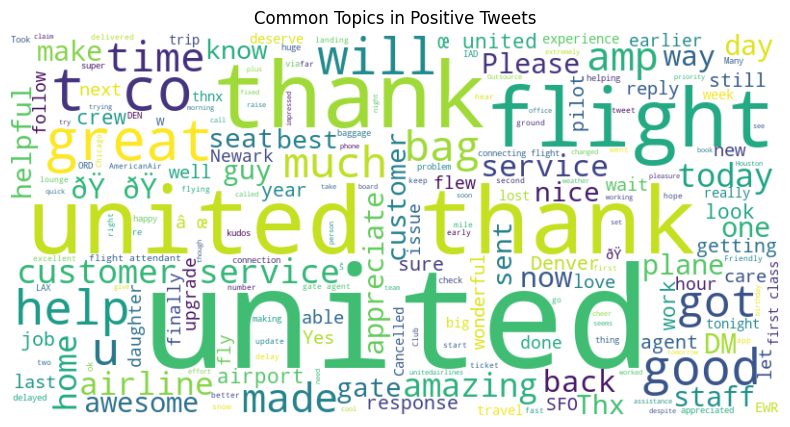

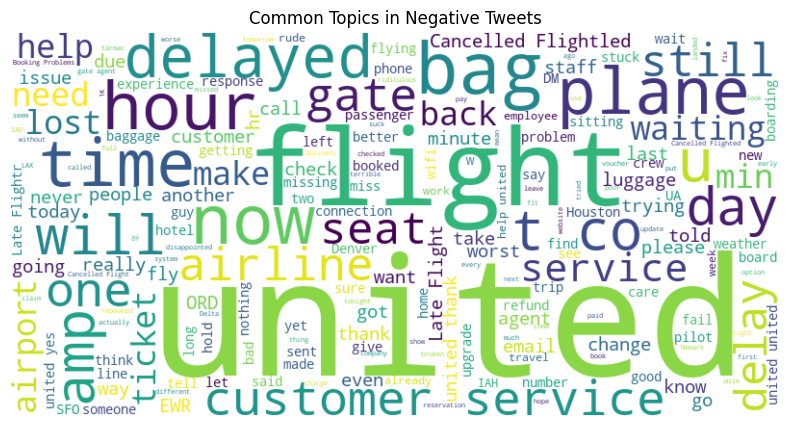

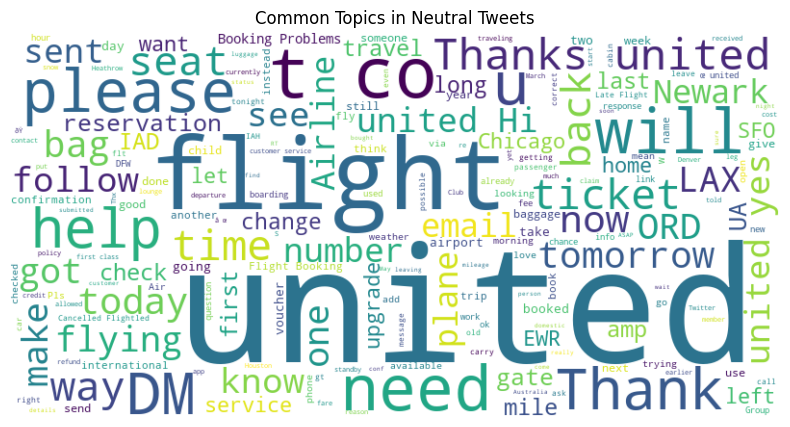

In [57]:
def generate_topic_wordcloud(df, sentiment):
    text = ' '.join(df[df['airline_sentiment'] == sentiment]['text'])
    wordcloud = WordCloud(
        width=800, height=400,
        background_color='white',
        stopwords=STOPWORDS
    ).generate(text)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Common Topics in {sentiment.title()} Tweets')
    plt.axis('off')
    plt.show()

for sentiment in ['positive', 'negative', 'neutral']:
    generate_topic_wordcloud(df, sentiment)

In [58]:
# Cell 10: Customer Service Response Analysis
# Calculate average retweet counts by sentiment
response_metrics = df.groupby('airline_sentiment')['retweet_count'].agg(['mean', 'count'])
print("\nEngagement Metrics by Sentiment:")
print(response_metrics)


Engagement Metrics by Sentiment:
                       mean  count
airline_sentiment                 
negative           0.147360   2633
neutral            0.037303    697
positive           0.014228    492


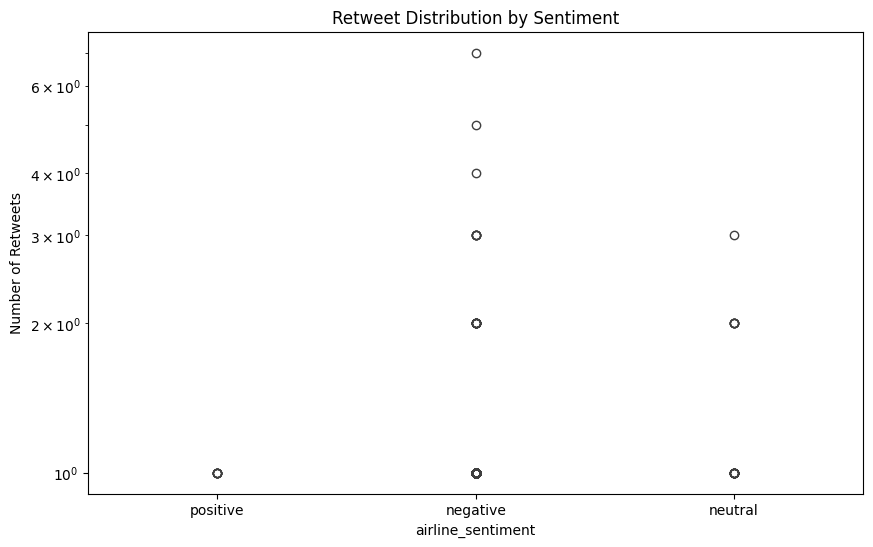

In [59]:
# Visualize retweet distribution
plt.figure(figsize=(10, 6))
sns.boxplot(x='airline_sentiment', y='retweet_count', data=df)
plt.title('Retweet Distribution by Sentiment')
plt.ylabel('Number of Retweets')
plt.yscale('log')  # Use log scale for better visualization
plt.show()

<Figure size 1200x600 with 0 Axes>

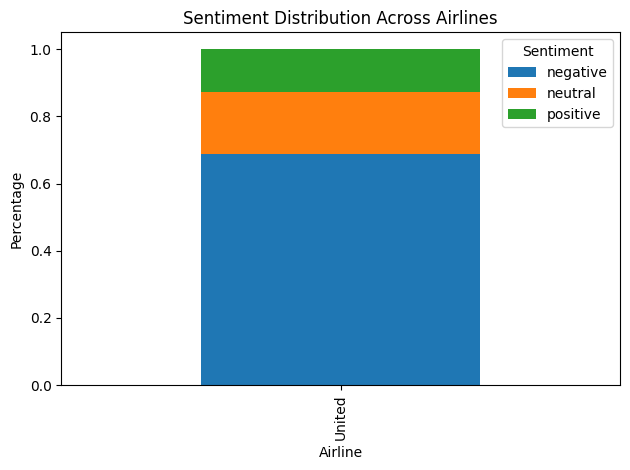

In [60]:
# Cell 11: Comparative Analysis with Other Airlines
airline_comparison = df.groupby('airline')['airline_sentiment'].value_counts(normalize=True).unstack()

plt.figure(figsize=(12, 6))
airline_comparison.plot(kind='bar', stacked=True)
plt.title('Sentiment Distribution Across Airlines')
plt.xlabel('Airline')
plt.ylabel('Percentage')
plt.legend(title='Sentiment')
plt.tight_layout()
plt.show()

In [61]:
# Cell 12: Key Findings Summary
print("Key Findings from the Analysis:")
print("\n1. Overall Sentiment Distribution:")
print(df['airline_sentiment'].value_counts(normalize=True).round(3) * 100)

print("\n2. Top Negative Reasons:")
print(df['negativereason'].value_counts().head())

print("\n3. Most Active Hours:")
print(df.groupby(df['tweet_created'].dt.hour).size().nlargest(5))

print("\n4. Geographic Hot Spots:")
print(df['tweet_location'].value_counts().head())

Key Findings from the Analysis:

1. Overall Sentiment Distribution:
airline_sentiment
negative    68.9
neutral     18.2
positive    12.9
Name: proportion, dtype: float64

2. Top Negative Reasons:
negativereason
Customer Service Issue    681
Late Flight               525
Can't Tell                379
Lost Luggage              269
Bad Flight                216
Name: count, dtype: int64

3. Most Active Hours:
tweet_created
9     255
14    237
15    234
13    232
10    216
dtype: int64

4. Geographic Hot Spots:
tweet_location
San Francisco, CA    42
Chicago, IL          40
Chicago              36
San Francisco        34
New York             34
Name: count, dtype: int64


In [62]:
!pip install pandas numpy matplotlib seaborn plotly textblob scikit-learn vaderSentiment networkx



[notice] A new release of pip is available: 24.0 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [63]:
# Title: Advanced Brand Reputation Management & Competitive Analysis
# Section: Multi-Company Social Media Sentiment Analysis

# Cell 1: Import Additional Libraries and Load Data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from textblob import TextBlob
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import networkx as nx
from datetime import datetime, timedelta


In [64]:
# Load both datasets
df1 = pd.read_csv('Tweets.csv')
df2 = pd.read_csv('Twitter2.csv')
# Combine datasets
combined_df = pd.concat([df1, df2], ignore_index=True)


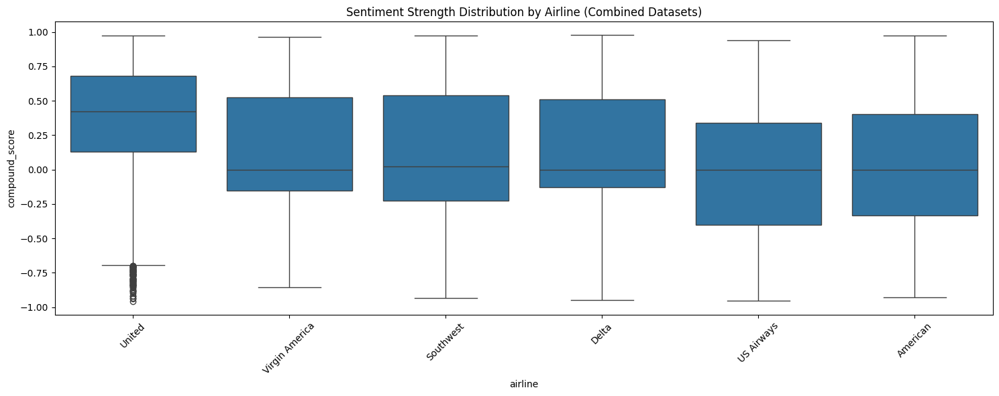


Sentiment Summary by Airline (Combined Datasets):
                 mean    std  count
airline                            
American        0.017  0.466   2759
Delta           0.137  0.458   2222
Southwest       0.138  0.475   2420
US Airways     -0.032  0.457   2913
United          0.342  0.419   3822
Virgin America  0.153  0.466    504

Sentiment Distribution by Airline:
compound_score  Negative  Neutral  Positive
airline                                    
American            1621      508       630
Delta               1182      334       706
Southwest           1207      389       824
US Airways          1830      513       570
United               790     1345      1687
Virgin America       258       76       170


<Figure size 1200x600 with 0 Axes>

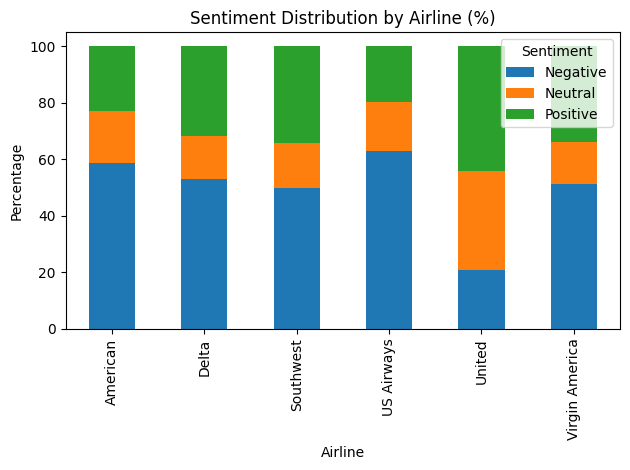

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Function to clean text
def clean_text(text):
    if pd.isna(text):
        return ""
    return str(text)

def calculate_sentiment_strength(text):
    analyzer = SentimentIntensityAnalyzer()
    clean_tweet = clean_text(text)
    scores = analyzer.polarity_scores(clean_tweet)
    return pd.Series({
        'compound_score': scores['compound'],
        'positive_strength': scores['pos'],
        'negative_strength': scores['neg'],
        'neutral_strength': scores['neu']
    })

try:
    # Load both datasets with proper data types
    dtype_dict = {
        'tweet_id': str,
        'airline_sentiment': str,
        'airline_sentiment_confidence': float,
        'negativereason': str,
        'negativereason_confidence': float,
        'airline': str,
        'airline_sentiment_gold': str,
        'name': str,
        'negativereason_gold': str,
        'retweet_count': float,
        'text': str,
        'tweet_coord': str,
        'tweet_created': str,
        'tweet_location': str,
        'user_timezone': str
    }

    # Load both datasets
    df1 = pd.read_csv('Tweets.csv', dtype=dtype_dict)
    df2 = pd.read_csv('Twitter2.csv', dtype=dtype_dict)
    
    # Combine datasets
    combined_df = pd.concat([df1, df2], ignore_index=True)
    
    # Calculate sentiment scores for the combined dataset
    sentiment_scores = combined_df['text'].apply(calculate_sentiment_strength)
    
    # Add sentiment scores to the combined dataframe
    combined_df = pd.concat([combined_df, sentiment_scores], axis=1)
    
    # Create the visualization
    plt.figure(figsize=(15, 6))
    sns.boxplot(x='airline', y='compound_score', data=combined_df)
    plt.title('Sentiment Strength Distribution by Airline (Combined Datasets)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    
    # Print summary statistics
    print("\nSentiment Summary by Airline (Combined Datasets):")
    summary = combined_df.groupby('airline')['compound_score'].agg(['mean', 'std', 'count']).round(3)
    print(summary)
    
    # Additional analysis: Sentiment distribution by airline
    print("\nSentiment Distribution by Airline:")
    sentiment_dist = pd.crosstab(combined_df['airline'], 
                                pd.qcut(combined_df['compound_score'], 
                                       q=3, labels=['Negative', 'Neutral', 'Positive']))
    print(sentiment_dist)
    
    # Create a percentage stacked bar plot
    sentiment_dist_pct = sentiment_dist.div(sentiment_dist.sum(axis=1), axis=0) * 100
    
    plt.figure(figsize=(12, 6))
    sentiment_dist_pct.plot(kind='bar', stacked=True)
    plt.title('Sentiment Distribution by Airline (%)')
    plt.xlabel('Airline')
    plt.ylabel('Percentage')
    plt.legend(title='Sentiment')
    plt.tight_layout()
    plt.show()

except Exception as e:
    print(f"An error occurred: {str(e)}")

# Optional: Save the results
# combined_df.to_csv('analyzed_tweets_combined.csv', index=False)

In [72]:
def create_competitive_benchmark(df):
    metrics = {}
    for airline in df['airline'].unique():
        airline_data = df[df['airline'] == airline]
        metrics[airline] = {
            'total_mentions': len(airline_data),
            'sentiment_ratio': airline_data['airline_sentiment'].value_counts(normalize=True).to_dict(),
            'avg_sentiment_strength': airline_data['compound_score'].mean(),
            'engagement_rate': airline_data['retweet_count'].mean(),
            'negative_topics': airline_data[airline_data['airline_sentiment'] == 'negative']['negativereason'].value_counts().head().to_dict(),
            'response_time': airline_data['tweet_created'].apply(pd.to_datetime).diff().mean()
        }
    return pd.DataFrame(metrics).T

benchmark_df = create_competitive_benchmark(combined_df)
print("Competitive Benchmark Analysis:")
print(benchmark_df)

Competitive Benchmark Analysis:
               total_mentions  \
United                   3822   
Virgin America            504   
Southwest                2420   
Delta                    2222   
US Airways               2913   
American                 2759   

                                                  sentiment_ratio  \
United          {'negative': 0.6889063317634746, 'neutral': 0....   
Virgin America  {'negative': 0.35912698412698413, 'neutral': 0...   
Southwest       {'negative': 0.4900826446280992, 'neutral': 0....   
Delta           {'negative': 0.4297929792979298, 'neutral': 0....   
US Airways      {'negative': 0.7768623412289736, 'neutral': 0....   
American        {'negative': 0.7104023196810438, 'neutral': 0....   

               avg_sentiment_strength engagement_rate  \
United                       0.341845        0.110152   
Virgin America               0.153268        0.051587   
Southwest                    0.138295        0.059917   
Delta                   


Analyzing United:
Word Distribution by Topic:


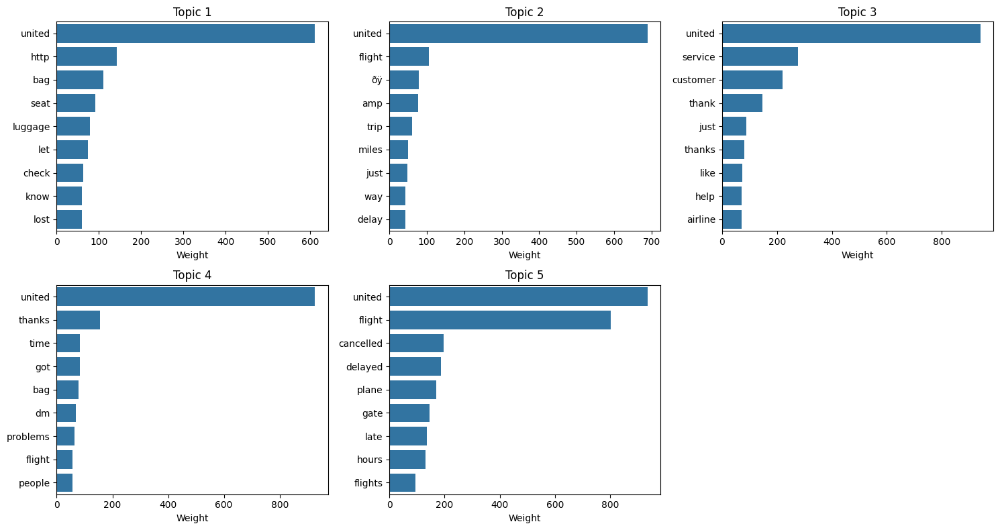


Topic WordClouds:


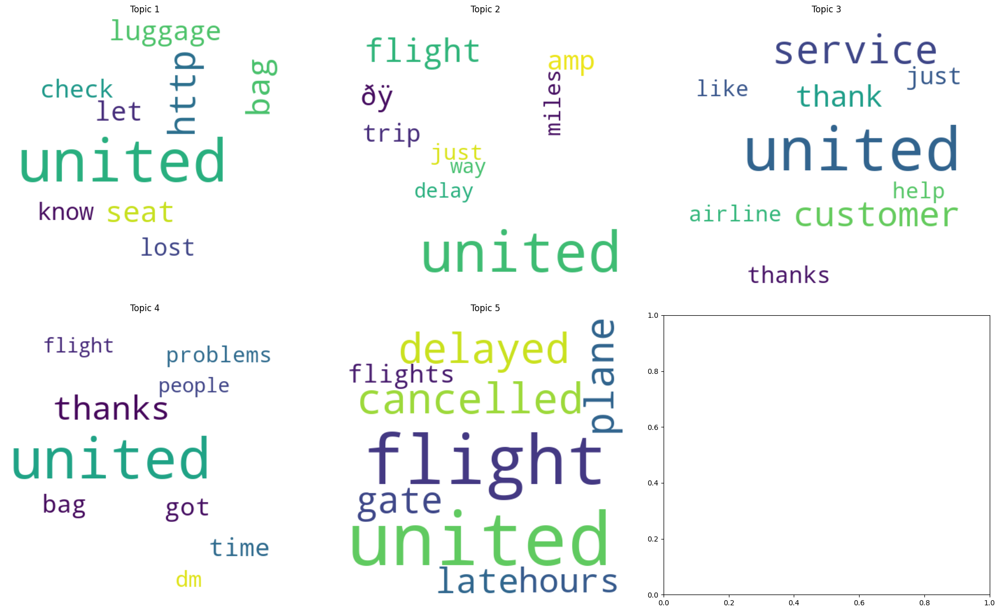


Topic Distribution Heatmap:


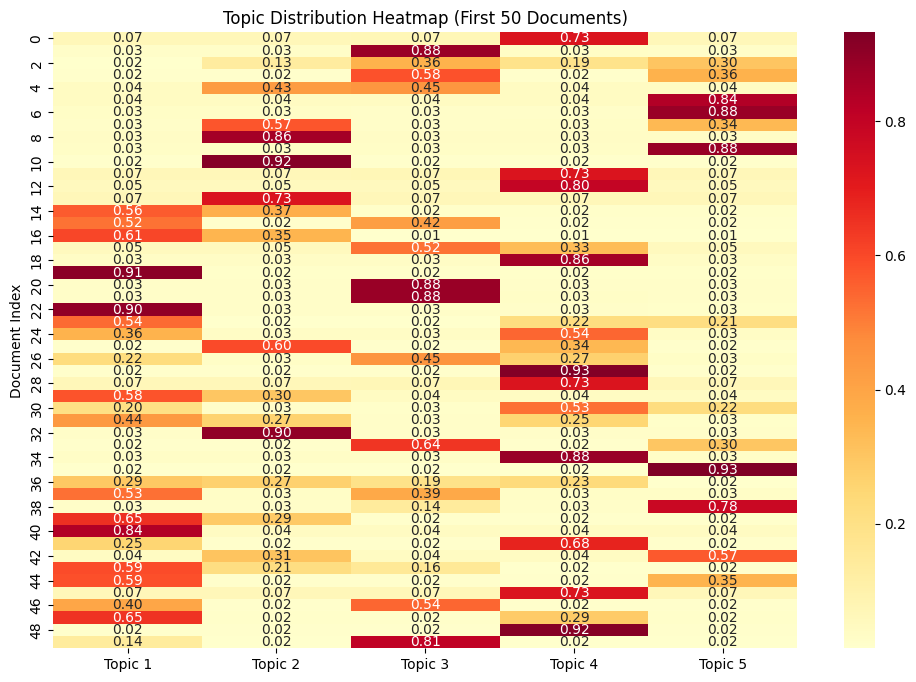


Analyzing Virgin America:
Word Distribution by Topic:


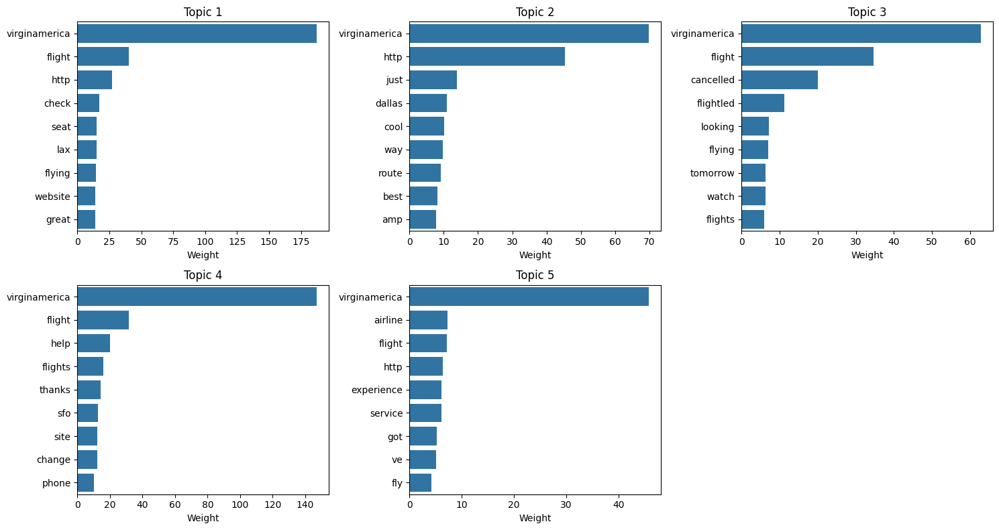


Topic WordClouds:


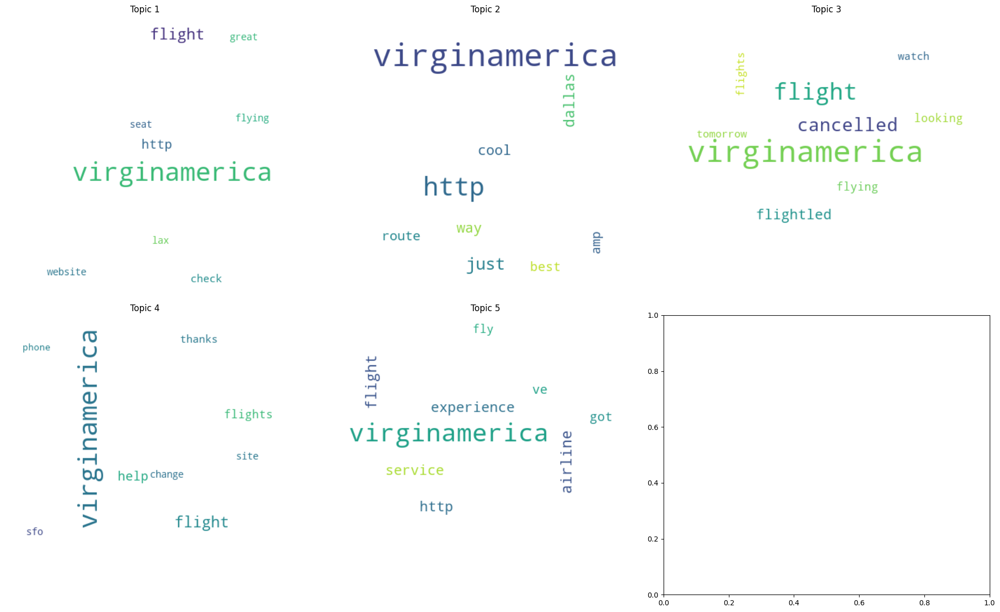


Topic Distribution Heatmap:


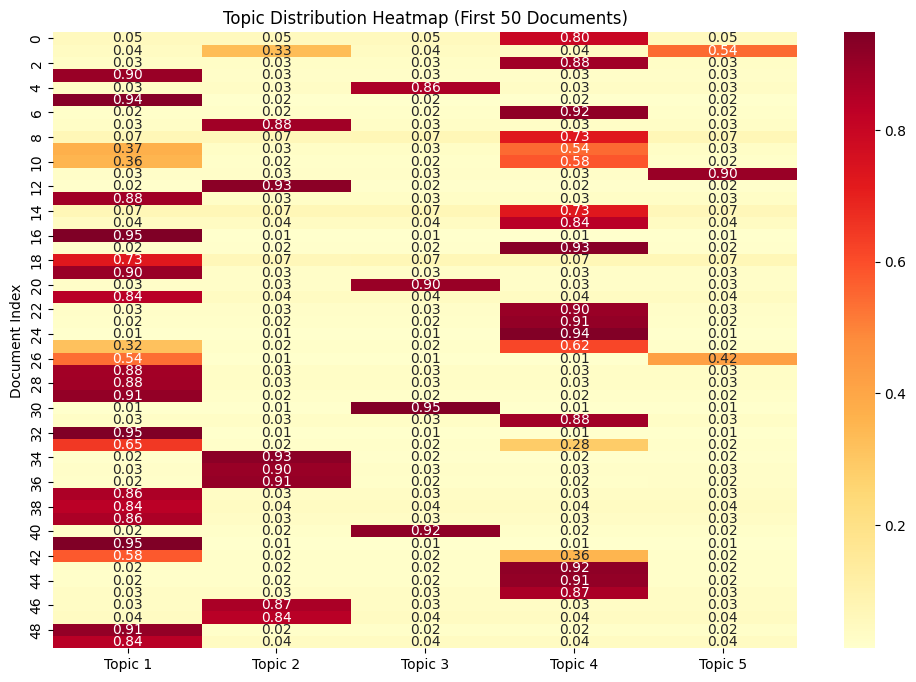


Analyzing Southwest:
Word Distribution by Topic:


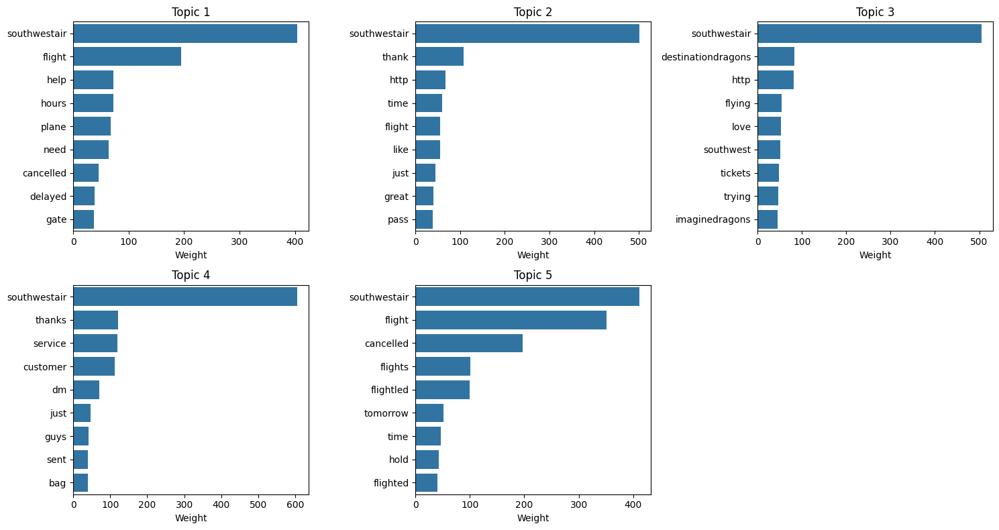


Topic WordClouds:


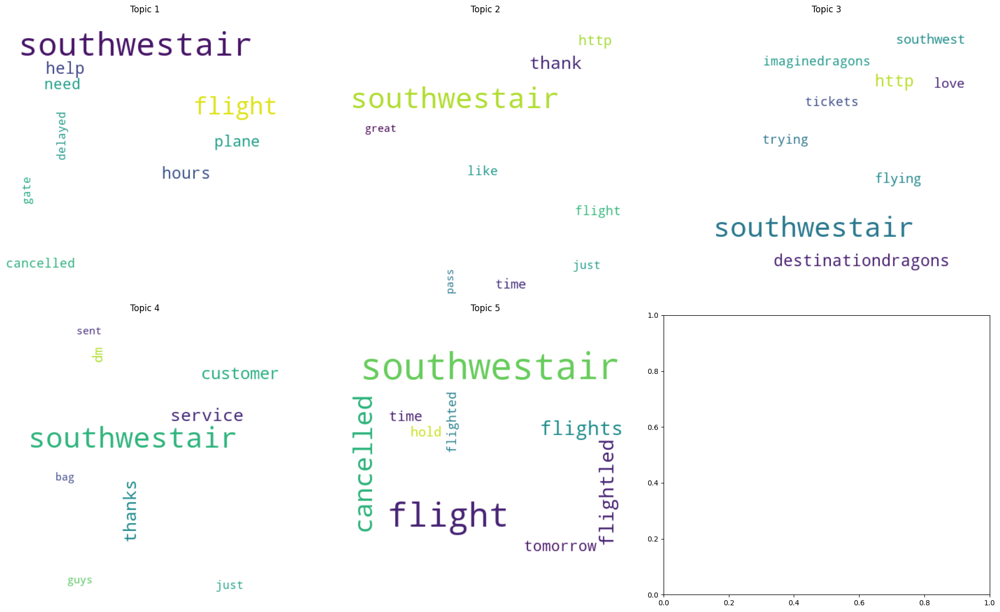


Topic Distribution Heatmap:


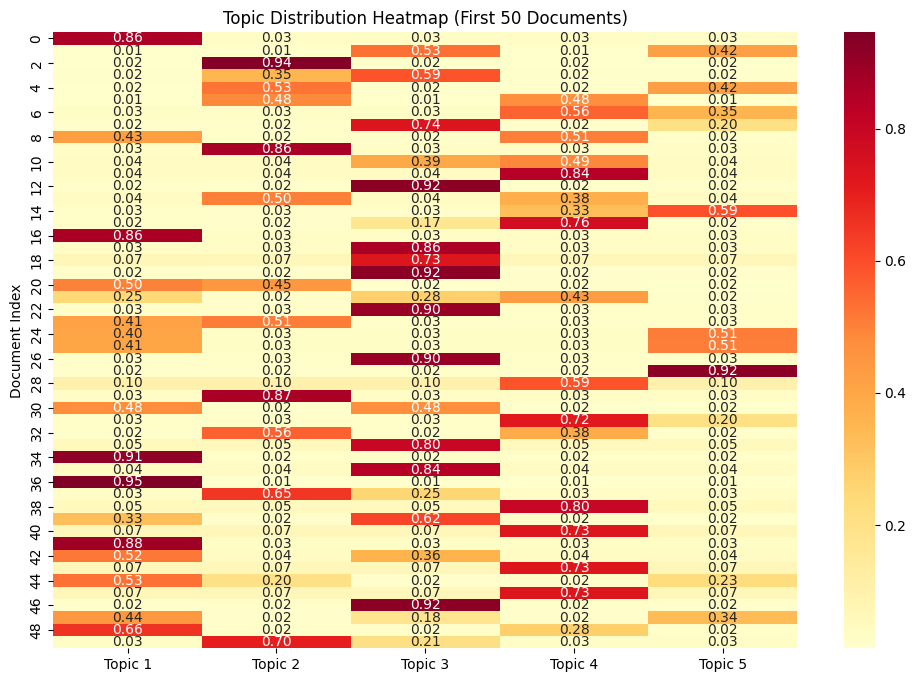


Analyzing Delta:
Word Distribution by Topic:


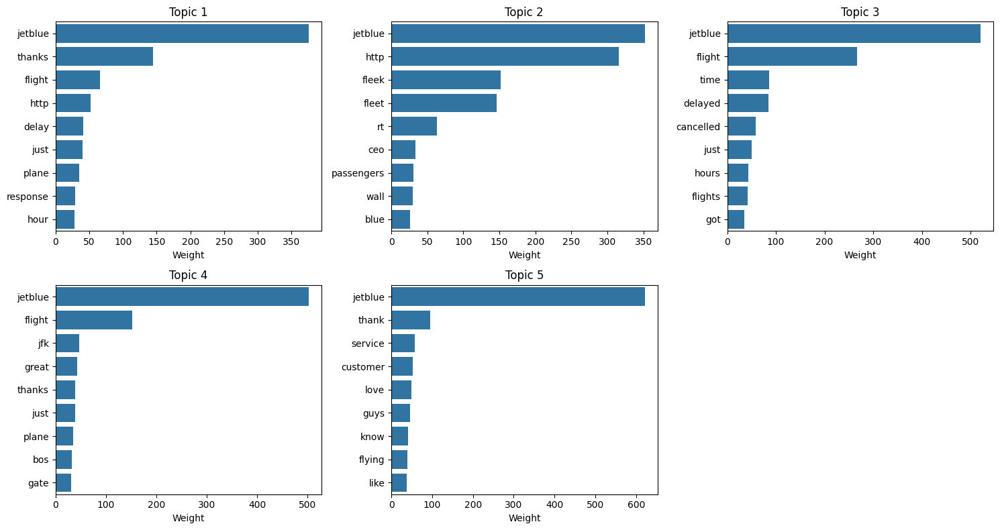


Topic WordClouds:


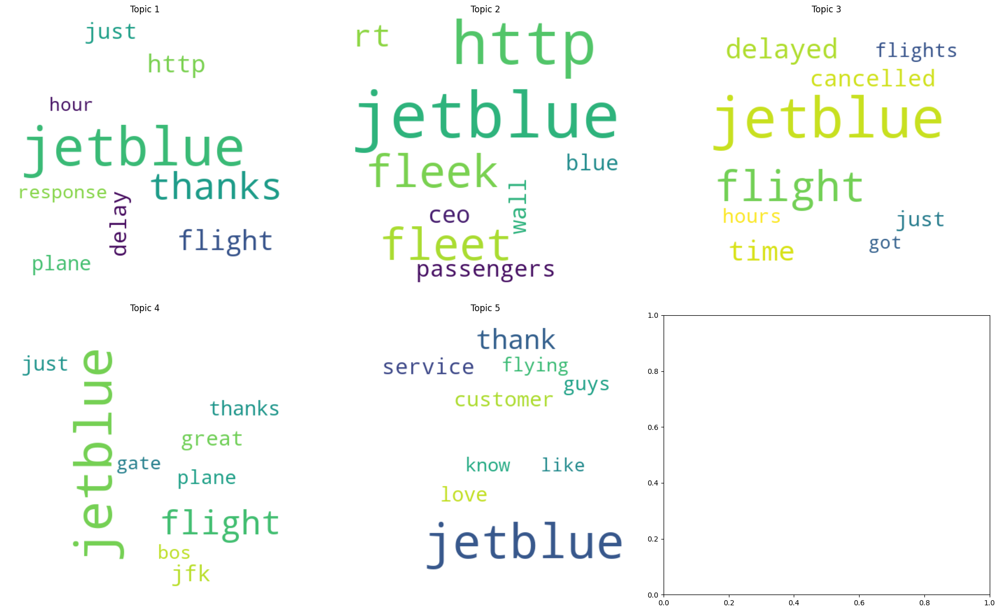


Topic Distribution Heatmap:


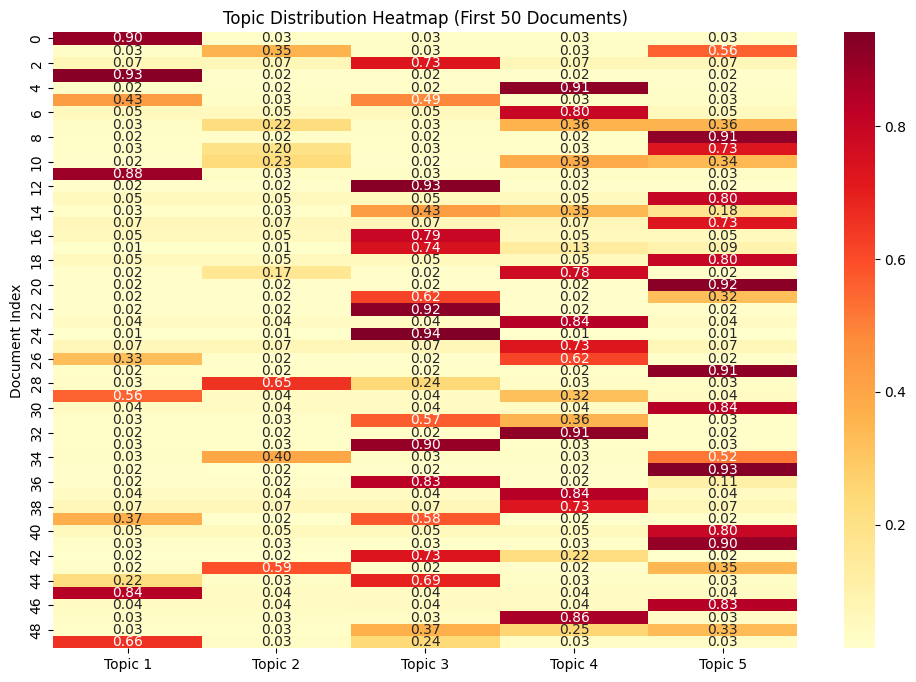


Analyzing US Airways:
Word Distribution by Topic:


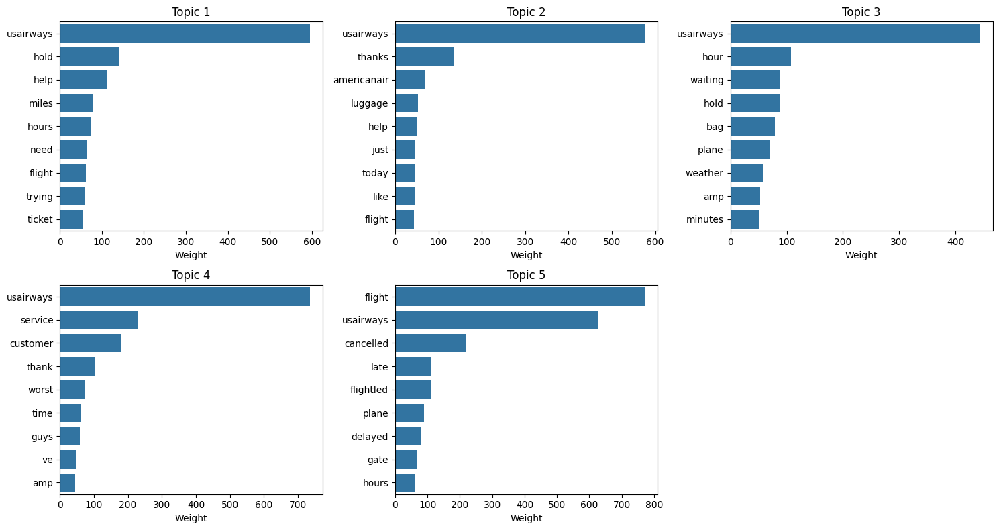


Topic WordClouds:


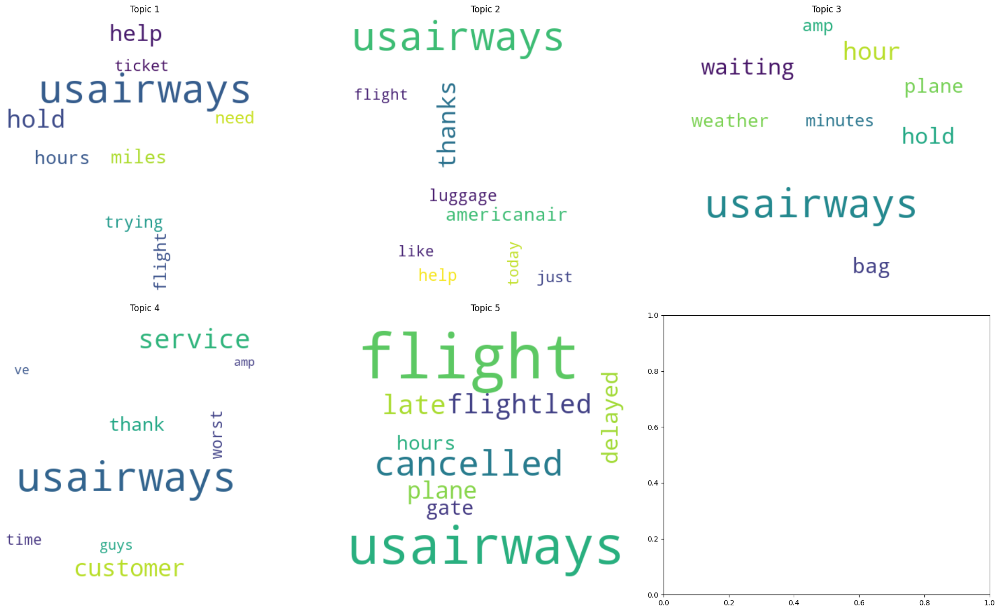


Topic Distribution Heatmap:


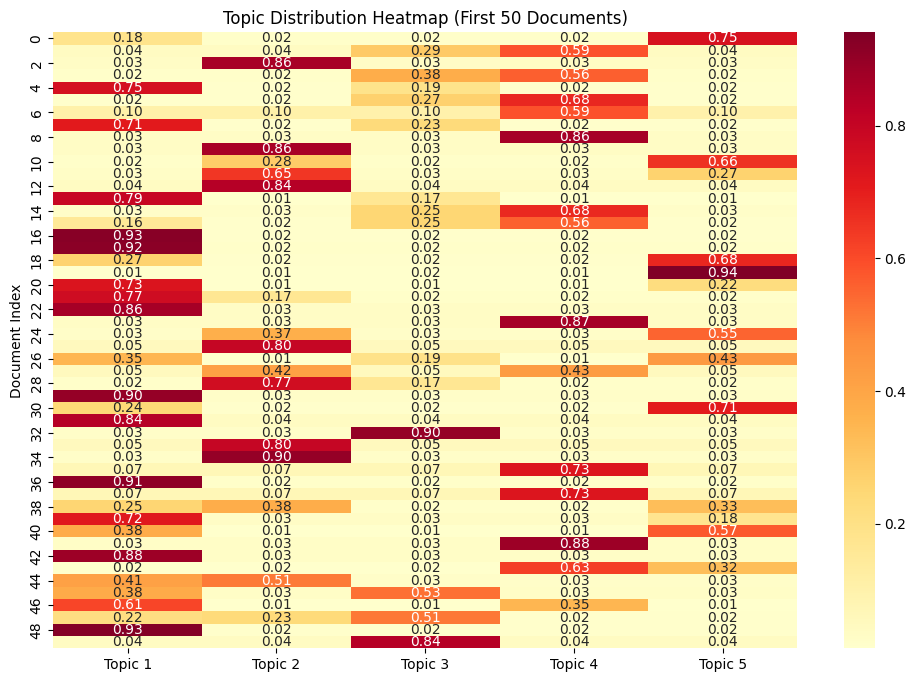


Analyzing American:
Word Distribution by Topic:


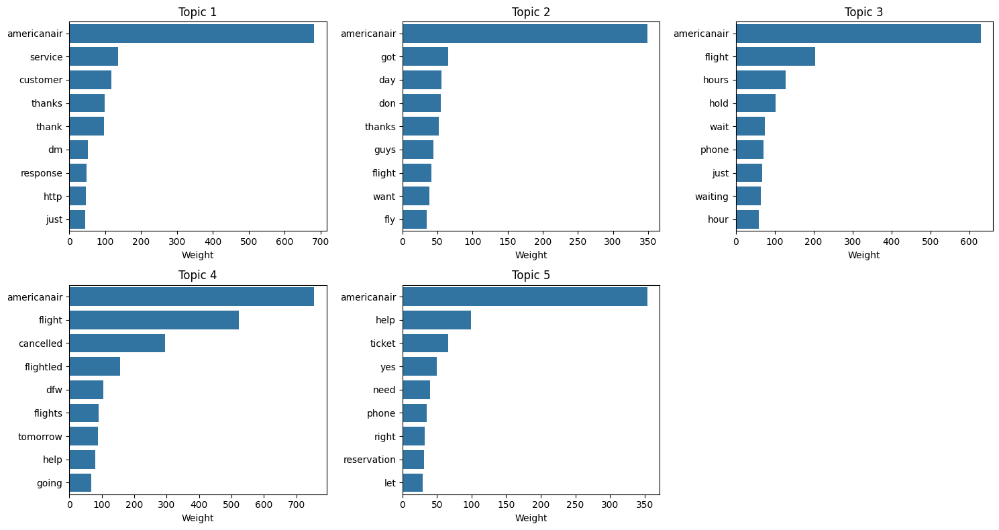


Topic WordClouds:


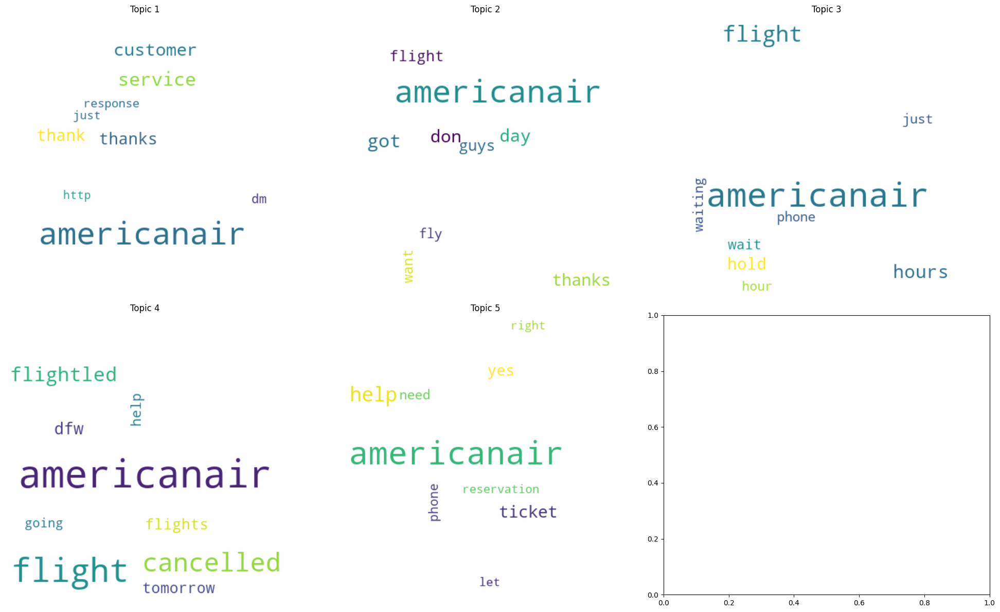


Topic Distribution Heatmap:


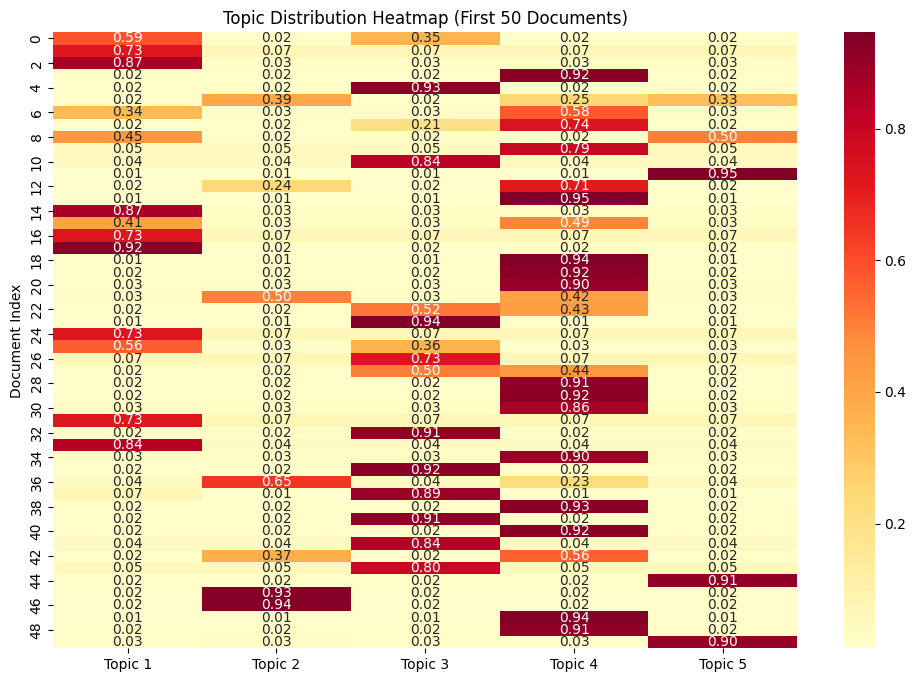

In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import plotly.express as px
import plotly.graph_objects as go
from wordcloud import WordCloud

def perform_topic_modeling_with_viz(df, n_topics=5):
    # Vectorization and LDA
    vectorizer = CountVectorizer(max_features=1000, stop_words='english')
    doc_term_matrix = vectorizer.fit_transform(df['text'])
    
    lda = LatentDirichletAllocation(n_components=n_topics, random_state=42)
    lda_output = lda.fit_transform(doc_term_matrix)
    
    # Get feature names and topics
    feature_names = vectorizer.get_feature_names_out()
    topics = []
    topic_word_weights = []
    
    for topic_idx, topic in enumerate(lda.components_):
        top_indices = topic.argsort()[:-10:-1]
        top_words = [feature_names[i] for i in top_indices]
        top_weights = [topic[i] for i in top_indices]
        topics.append(top_words)
        topic_word_weights.append(top_weights)
    
    # Create visualizations
    def plot_topic_word_distributions(topics, topic_word_weights):
        plt.figure(figsize=(15, 8))
        for idx, (words, weights) in enumerate(zip(topics, topic_word_weights)):
            plt.subplot(2, 3, idx + 1)
            sns.barplot(x=weights, y=words)
            plt.title(f'Topic {idx + 1}')
            plt.xlabel('Weight')
        plt.tight_layout()
        plt.show()
    
    def create_topic_wordcloud(topics, topic_word_weights):
        fig, axes = plt.subplots(2, 3, figsize=(20, 12))
        axes = axes.flatten()
        
        for idx, (words, weights) in enumerate(zip(topics, topic_word_weights)):
            if idx < len(axes):
                word_freq = dict(zip(words, weights))
                wordcloud = WordCloud(width=400, height=400, background_color='white').generate_from_frequencies(word_freq)
                axes[idx].imshow(wordcloud, interpolation='bilinear')
                axes[idx].axis('off')
                axes[idx].set_title(f'Topic {idx + 1}')
        
        plt.tight_layout()
        plt.show()
    
    def create_topic_heatmap(lda_output):
        topic_probs = pd.DataFrame(lda_output)
        topic_probs.columns = [f'Topic {i+1}' for i in range(n_topics)]
        
        plt.figure(figsize=(12, 8))
        sns.heatmap(topic_probs.head(50), cmap='YlOrRd', annot=True, fmt='.2f')
        plt.title('Topic Distribution Heatmap (First 50 Documents)')
        plt.ylabel('Document Index')
        plt.show()
    
    # Generate all visualizations
    print("Word Distribution by Topic:")
    plot_topic_word_distributions(topics, topic_word_weights)
    
    print("\nTopic WordClouds:")
    create_topic_wordcloud(topics, topic_word_weights)
    
    print("\nTopic Distribution Heatmap:")
    create_topic_heatmap(lda_output)
    
    return topics, lda_output

# Example usage:
# Analyze topics by airline
results = {}
for airline in combined_df['airline'].unique():
    print(f"\nAnalyzing {airline}:")
    airline_df = combined_df[combined_df['airline'] == airline]
    topics, distributions = perform_topic_modeling_with_viz(airline_df)
    results[airline] = {'topics': topics, 'distributions': distributions}


Network Statistics for United:
Number of nodes: 346
Number of edges: 695
Average degree: 4.02

Most common word connections:
for - the: 128 occurrences
customer - service: 111 occurrences
thanks - for: 109 occurrences
you - can: 84 occurrences
you - thank: 70 occurrences
cancelled - flightled: 65 occurrences
flight - late: 62 occurrences
you - guys: 48 occurrences
the - plane: 46 occurrences
been - has: 46 occurrences


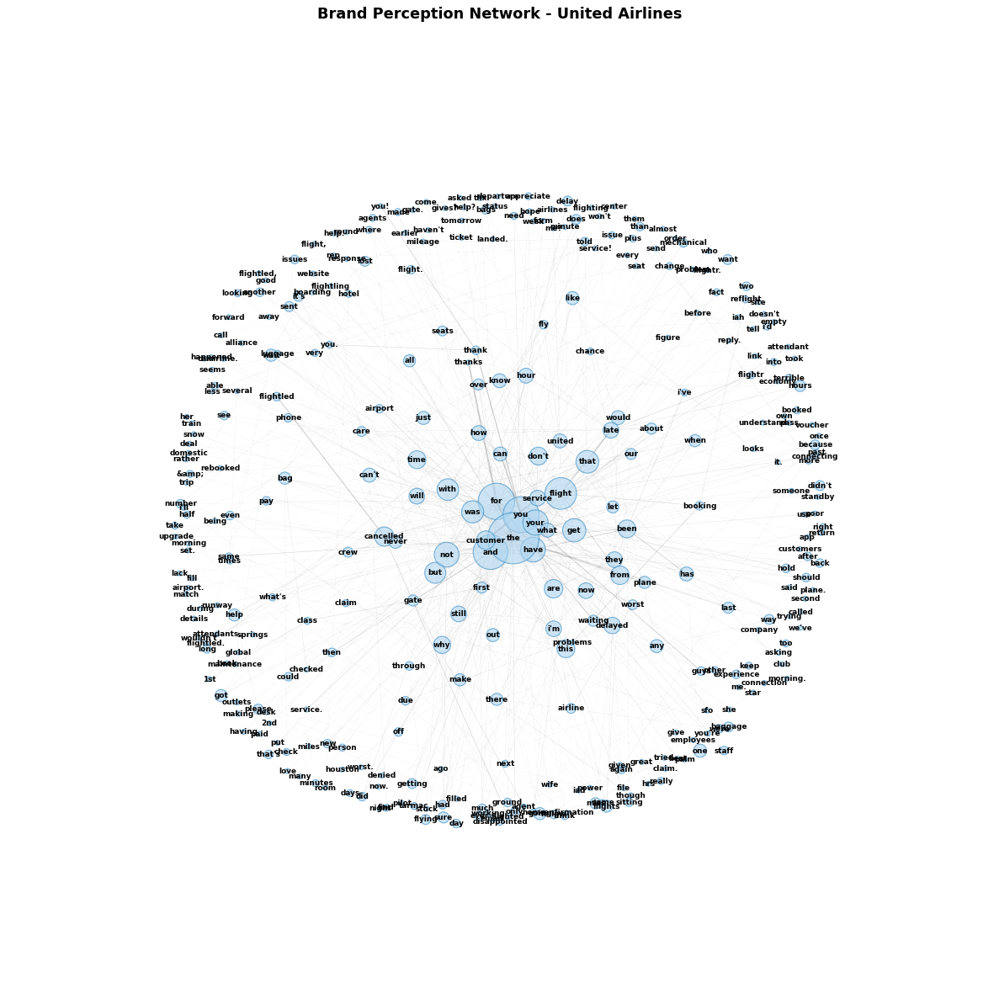

In [88]:
 import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
from collections import Counter
def create_brand_network(df, airline, min_weight=5):
    G = nx.Graph()
    airline_tweets = df[df['airline'] == airline]['text']

    # Create word pairs and their frequencies
    word_pairs = []
    for tweet in airline_tweets:
        # Clean and split the text
        words = [word.lower() for word in tweet.split() 
                if len(word) > 2 and not word.startswith('@')]
        # Create pairs of adjacent words
        pairs = [(words[i], words[i+1]) for i in range(len(words)-1)]
        word_pairs.extend(pairs)

    # Count pair frequencies
    pair_counts = Counter(word_pairs)

    # Add edges with weights, filtering for minimum weight
    for (word1, word2), weight in pair_counts.items():
        if weight >= min_weight:  # Only add edges with weight >= min_weight
            G.add_edge(word1, word2, weight=weight)

    # Remove isolated nodes
    G.remove_nodes_from(list(nx.isolates(G)))

    return G
def visualize_brand_network(df, airline, min_weight=5):
    # Set figure size and use a clean style
    plt.style.use('classic')
    fig = plt.figure(figsize=(15, 15), facecolor='white')
    ax = plt.gca()
    ax.set_facecolor('white')

    # Create and layout the network
    G = create_brand_network(df, airline, min_weight)

    # Use force-directed layout with adjusted parameters
    pos = nx.spring_layout(G, k=1.5, iterations=50, seed=42)

    # Get edge weights for width scaling
    edges = G.edges()
    weights = [G[u][v]['weight'] for u, v in edges]
    max_weight = max(weights)

    # Normalize edge widths and node sizes
    edge_widths = [2 * w/max_weight for w in weights]
    node_sizes = [3000 * G.degree(node) / max(dict(G.degree()).values()) for node in G.nodes()]

    # Draw the network elements
    nx.draw_networkx_edges(G, pos, 
                          width=edge_widths, 
                          alpha=0.3, 
                          edge_color='#666666')

    nx.draw_networkx_nodes(G, pos,
                          node_size=node_sizes,
                          node_color='#AED6F1',  # Light blue
                          alpha=0.6,
                          edgecolors='#2E86C1')  # Darker blue edge

    nx.draw_networkx_labels(G, pos,
                           font_size=8,
                           font_weight='bold',
                           font_family='sans-serif')

    # Add title
    plt.title(f'Brand Perception Network - {airline} Airlines', 
              fontsize=16, 
              pad=20,
              fontweight='bold')

    plt.axis('off')
    plt.tight_layout()

    # Print network statistics
    print(f"\nNetwork Statistics for {airline}:")
    print(f"Number of nodes: {G.number_of_nodes()}")
    print(f"Number of edges: {G.number_of_edges()}")
    print(f"Average degree: {sum(dict(G.degree()).values())/G.number_of_nodes():.2f}")

    # Print most common word pairs
    print("\nMost common word connections:")
    sorted_edges = sorted(G.edges(data=True), 
                        key=lambda x: x[2]['weight'], 
                        reverse=True)
    for word1, word2, data in sorted_edges[:10]:
        print(f"{word1} - {word2}: {data['weight']} occurrences")

    plt.show()
# Example usage
visualize_brand_network(combined_df, 'United', min_weight=5)

In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def analyze_sentiment_trends(df):
    """
    Analyze and plot airline sentiment trends over time from tweet data.
    Handles mixed date formats in the data.
    
    Parameters:
    df (pandas.DataFrame): DataFrame containing 'tweet_created', 'airline', and 'airline_sentiment' columns
    """
    try:
        # Create a copy to avoid modifying original dataframe
        df_copy = df.copy()
        
        # Convert sentiment to numeric values
        sentiment_map = {'positive': 1, 'neutral': 0, 'negative': -1}
        df_copy['sentiment_score'] = df_copy['airline_sentiment'].map(sentiment_map)
        
        # Handle mixed date formats using a custom converter
        def convert_date(date_str):
            try:
                # Try first format (MM/DD/YYYY HH:MM:SS)
                return pd.to_datetime(date_str, format='%m/%d/%Y %H:%M:%S')
            except:
                try:
                    # Try second format (DD-MM-YYYY HH:MM)
                    return pd.to_datetime(date_str, format='%d-%m-%Y %H:%M')
                except:
                    # If both fail, let pandas try to infer the format
                    return pd.to_datetime(date_str)
        
        # Convert dates using the custom converter
        df_copy['tweet_created'] = df_copy['tweet_created'].apply(convert_date)
        
        # Extract date component
        df_copy['date'] = df_copy['tweet_created'].dt.date
        
        # Calculate mean sentiment scores by date and airline
        sentiment_trends = df_copy.groupby(['date', 'airline'])['sentiment_score'].mean().unstack()
        
        # Create the plot
        plt.figure(figsize=(15, 6))
        
        # Plot with different line styles and markers for better visibility
        colors = sns.color_palette("husl", n_colors=len(sentiment_trends.columns))
        for (column, color) in zip(sentiment_trends.columns, colors):
            plt.plot(sentiment_trends.index, sentiment_trends[column], 
                    marker='o', label=column, linewidth=2, markersize=6,
                    color=color)
        
        # Customize plot appearance
        plt.title('Airline Sentiment Trends Over Time', fontsize=14, pad=20)
        plt.xlabel('Date', fontsize=12)
        plt.ylabel('Average Sentiment Score\n(-1: Negative, 0: Neutral, 1: Positive)', fontsize=12)
        plt.legend(title='Airline', bbox_to_anchor=(1.05, 1))
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Rotate x-axis labels for better readability
        plt.xticks(rotation=45)
        
        # Add horizontal line at y=0 to show neutral sentiment
        plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
        
        # Adjust layout to prevent label cutoff
        plt.tight_layout()
        
        # Display the plot
        plt.show()
        
        # Print summary statistics
        print("\nSentiment Summary by Airline:")
        summary = df_copy.groupby('airline').agg({
            'sentiment_score': ['mean', 'count']
        }).round(3)
        summary.columns = ['Average Sentiment', 'Number of Tweets']
        print(summary)
        
        # Print date range of data
        print("\nDate Range of Analysis:")
        print(f"Start Date: {df_copy['date'].min()}")
        print(f"End Date: {df_copy['date'].max()}")
        
        return sentiment_trends
        
    except Exception as e:
        print(f"Error in analysis: {str(e)}")
        print("Please check your data format and ensure all required columns are present.")
        return None

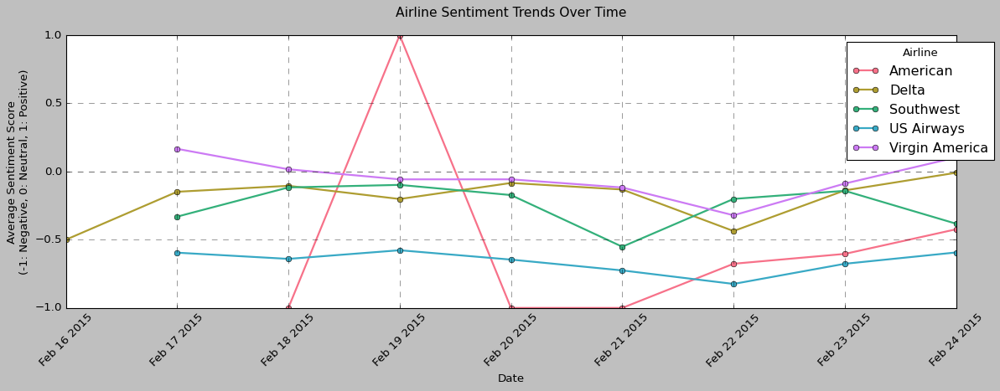


Sentiment Summary by Airline:
                Average Sentiment  Number of Tweets
airline                                            
American                   -0.589              2759
Delta                      -0.185              2222
Southwest                  -0.255              2420
US Airways                 -0.685              2913
Virgin America             -0.058               504

Date Range of Analysis:
Start Date: 2015-02-16
End Date: 2015-02-24


airline,American,Delta,Southwest,US Airways,Virgin America
date,,,,,
2015-02-16,NaN,-0.500000,NaN,NaN,NaN
2015-02-17,NaN,-0.148289,-0.330729,-0.594855,0.166667
2015-02-18,-1.000000,-0.104478,-0.116438,-0.640379,0.016667
2015-02-19,1.000000,-0.201413,-0.097792,-0.577061,-0.057143
2015-02-20,-1.000000,-0.083665,-0.172414,-0.645646,-0.057143
2015-02-21,-1.000000,-0.131687,-0.551351,-0.725000,-0.116883
2015-02-22,-0.676113,-0.436275,-0.200717,-0.824074,-0.320755
2015-02-23,-0.603856,-0.138107,-0.141304,-0.676230,-0.087912
2015-02-24,-0.423323,-0.008850,-0.382514,-0.593220,0.103448


In [95]:
analyze_sentiment_trends(df)

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def analyze_satisfaction_trends(df):
    """
    Analyze and plot customer satisfaction trends over time from airline tweet data.
    Handles mixed date formats and converts sentiment to numeric scores.
    
    Parameters:
    df (pandas.DataFrame): DataFrame containing 'tweet_created', 'airline', and 'airline_sentiment' columns
    """
    try:
        # Create a copy to avoid modifying original dataframe
        df_copy = df.copy()
        
        # Convert sentiment to numeric values
        sentiment_map = {'positive': 1, 'neutral': 0, 'negative': -1}
        df_copy['sentiment_score'] = df_copy['airline_sentiment'].map(sentiment_map)
        
        # Handle mixed date formats using a custom converter
        def convert_date(date_str):
            try:
                # Try first format (MM/DD/YYYY HH:MM:SS)
                return pd.to_datetime(date_str, format='%m/%d/%Y %H:%M:%S')
            except:
                try:
                    # Try second format (DD-MM-YYYY HH:MM)
                    return pd.to_datetime(date_str, format='%d-%m-%Y %H:%M')
                except:
                    # If both fail, let pandas try to infer the format
                    return pd.to_datetime(date_str)
        
        # Convert dates using the custom converter
        df_copy['tweet_created'] = df_copy['tweet_created'].apply(convert_date)
        df_copy['date'] = df_copy['tweet_created'].dt.date
        
        # Calculate satisfaction trends
        satisfaction_trends = df_copy.groupby(['date', 'airline'])['sentiment_score'].mean().unstack()
        
        # Create the plot with enhanced styling
        plt.figure(figsize=(15, 6))
        
        # Use a distinct color palette
        colors = sns.color_palette("husl", n_colors=len(satisfaction_trends.columns))
        
        # Plot each airline's trend
        for (airline, color) in zip(satisfaction_trends.columns, colors):
            plt.plot(satisfaction_trends.index, satisfaction_trends[airline],
                    marker='o', label=airline, linewidth=2, markersize=6,
                    color=color)
        
        # Enhance plot appearance
        plt.title('Customer Satisfaction Trends Over Time', fontsize=14, pad=20)
        plt.xlabel('Date', fontsize=12)
        plt.ylabel('Average Sentiment Score\n(-1: Negative, 0: Neutral, 1: Positive)', fontsize=12)
        plt.legend(title='Airline', bbox_to_anchor=(1.05, 1))
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Add reference line for neutral sentiment
        plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
        
        # Rotate date labels for better readability
        plt.xticks(rotation=45)
        
        # Adjust layout to prevent label cutoff
        plt.tight_layout()
        
        # Display the plot
        plt.show()
        
        # Print summary statistics
        print("\nSatisfaction Summary by Airline:")
        summary = df_copy.groupby('airline').agg({
            'sentiment_score': ['mean', 'count', 'std']
        }).round(3)
        summary.columns = ['Average Sentiment', 'Number of Tweets', 'Standard Deviation']
        print(summary)
        
        # Print date range
        print("\nAnalysis Period:")
        print(f"Start Date: {df_copy['date'].min()}")
        print(f"End Date: {df_copy['date'].max()}")
        
        return satisfaction_trends
    
    except Exception as e:
        print(f"Error in analysis: {str(e)}")
        print("Please check your data format and ensure all required columns are present.")
        return None

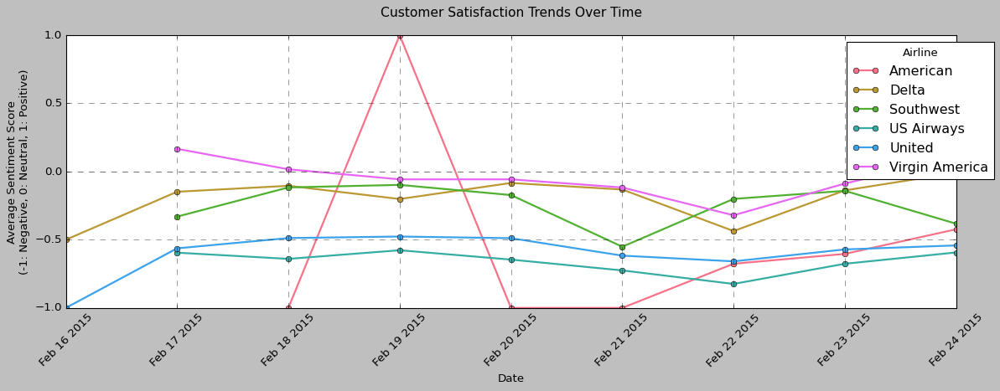


Satisfaction Summary by Airline:
                Average Sentiment  Number of Tweets  Standard Deviation
airline                                                                
American                   -0.589              2759               0.697
Delta                      -0.185              2222               0.800
Southwest                  -0.255              2420               0.813
US Airways                 -0.685              2913               0.633
United                     -0.560              3822               0.710
Virgin America             -0.058               504               0.812

Analysis Period:
Start Date: 2015-02-16
End Date: 2015-02-24


In [97]:
# Assuming your DataFrame is named 'combined_df'
satisfaction_results = analyze_satisfaction_trends(combined_df)

In [98]:
# Cell 7: Response Effectiveness Analysis
def analyze_response_effectiveness(df):
    response_metrics = df.groupby('airline').agg({
        'retweet_count': ['mean', 'max'],
        'compound_score': ['mean', 'std'],
    }).round(2)
    
    # Visualize response effectiveness
    fig = go.Figure()
    for airline in response_metrics.index:
        fig.add_trace(go.Scatter(
            x=[response_metrics.loc[airline, ('retweet_count', 'mean')]],
            y=[response_metrics.loc[airline, ('compound_score', 'mean')]],
            mode='markers+text',
            name=airline,
            text=[airline],
            marker=dict(size=20),
            textposition="top center"
        ))
    
    fig.update_layout(
        title='Response Effectiveness by Airline',
        xaxis_title='Average Retweets',
        yaxis_title='Average Sentiment Score'
    )
    fig.show()

analyze_response_effectiveness(combined_df)


In [102]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import timedelta

def detect_brand_crisis(df, sentiment_threshold=-0.3, volume_multiplier=1.2):
    """
    Detect potential brand crisis points based on sentiment and tweet volume.
    
    Parameters:
    df (pandas.DataFrame): DataFrame containing tweet data
    sentiment_threshold (float): Base sentiment threshold for crisis detection (default: -0.3)
    volume_multiplier (float): Multiplier for mean volume to detect spikes (default: 1.2)
    """
    try:
        # Create a copy to avoid modifying original dataframe
        df_copy = df.copy()
        
        # Convert sentiment to numeric values
        sentiment_map = {'positive': 1, 'neutral': 0, 'negative': -1}
        df_copy['sentiment_score'] = df_copy['airline_sentiment'].map(sentiment_map)
        
        # Handle mixed date formats
        def convert_date(date_str):
            try:
                return pd.to_datetime(date_str, format='%m/%d/%Y %H:%M:%S')
            except:
                try:
                    return pd.to_datetime(date_str, format='%d-%m-%Y %H:%M')
                except:
                    return pd.to_datetime(date_str)
        
        # Convert dates and floor to hour
        df_copy['tweet_created'] = df_copy['tweet_created'].apply(convert_date)
        df_copy['hour'] = df_copy['tweet_created'].dt.floor('H')
        
        # Calculate hourly metrics
        hourly_metrics = df_copy.groupby(['hour', 'airline']).agg({
            'sentiment_score': ['mean', 'count'],
            'airline_sentiment_confidence': 'mean'
        }).reset_index()
        
        # Flatten column names
        hourly_metrics.columns = ['hour', 'airline', 'avg_sentiment', 'tweet_volume', 'avg_confidence']
        
        # Print data distribution information for debugging
        print("\nData Distribution Summary:")
        print(f"Total hours analyzed: {len(hourly_metrics)}")
        print("\nSentiment Distribution:")
        print(hourly_metrics['avg_sentiment'].describe())
        print("\nVolume Distribution:")
        print(hourly_metrics['tweet_volume'].describe())
        
        # Calculate baseline metrics per airline
        airline_baselines = df_copy.groupby('airline').agg({
            'sentiment_score': ['mean', 'std'],
            'airline_sentiment_confidence': 'mean'
        })
        
        # Detect crisis points using adjusted thresholds
        crisis_points = hourly_metrics[
            (hourly_metrics['avg_sentiment'] < sentiment_threshold) &
            (hourly_metrics['tweet_volume'] > hourly_metrics.groupby('airline')['tweet_volume'].transform('mean') * volume_multiplier)
        ].copy()
        
        # Plot all data points regardless of crisis detection
        plt.figure(figsize=(15, 8))
        
        # Create scatter plot of all points
        colors = sns.color_palette("husl", n_colors=len(df_copy['airline'].unique()))
        for airline, color in zip(df_copy['airline'].unique(), colors):
            airline_data = hourly_metrics[hourly_metrics['airline'] == airline]
            plt.scatter(airline_data['hour'], airline_data['avg_sentiment'], 
                      alpha=0.3, color=color, label=airline, s=50)
            
            # Highlight crisis points if any
            if not crisis_points.empty:
                crisis_airline = crisis_points[crisis_points['airline'] == airline]
                if not crisis_airline.empty:
                    plt.scatter(crisis_airline['hour'], crisis_airline['avg_sentiment'],
                              color=color, s=200, marker='*', label=f'{airline} Crisis')
        
        plt.axhline(y=sentiment_threshold, color='red', linestyle='--', alpha=0.5, 
                   label='Crisis Threshold')
        plt.title('Airline Sentiment Overview\n(Stars indicate crisis points)', pad=20)
        plt.xlabel('Date and Time')
        plt.ylabel('Average Sentiment Score')
        plt.legend(bbox_to_anchor=(1.05, 1))
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        if not crisis_points.empty:
            # Calculate crisis severity
            crisis_points['crisis_severity'] = (
                -crisis_points['avg_sentiment'] * 
                crisis_points['tweet_volume'] * 
                crisis_points['avg_confidence']
            )
            crisis_points = crisis_points.sort_values('crisis_severity', ascending=False)
            
            print("\nCrisis Points Detected:")
            summary_cols = ['hour', 'airline', 'avg_sentiment', 'tweet_volume', 'crisis_severity']
            print(crisis_points[summary_cols].to_string(index=False))
        else:
            print("\nNo crisis points detected with current thresholds.")
            print(f"Consider adjusting thresholds (current settings: sentiment < {sentiment_threshold}, volume multiplier = {volume_multiplier})")
        
        return crisis_points
        
    except Exception as e:
        print(f"Error in crisis detection: {str(e)}")
        print("Please check your data format and ensure all required columns are present.")
        return None


Data Distribution Summary:
Total hours analyzed: 874

Sentiment Distribution:
count    874.000000
mean      -0.364252
std        0.447552
min       -1.000000
25%       -0.668899
50%       -0.461538
75%       -0.065580
max        1.000000
Name: avg_sentiment, dtype: float64

Volume Distribution:
count    874.000000
mean      16.750572
std       16.582386
min        1.000000
25%        5.000000
50%       13.000000
75%       23.000000
max      126.000000
Name: tweet_volume, dtype: float64


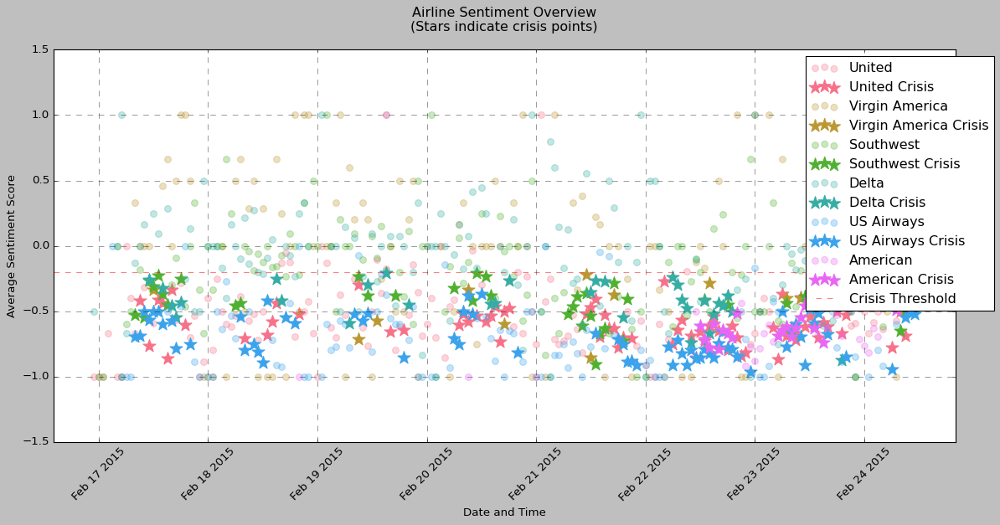


Crisis Points Detected:
               hour        airline  avg_sentiment  tweet_volume  crisis_severity
2015-02-22 16:00:00       American      -0.792453           106        79.653079
2015-02-22 14:00:00       American      -0.776699           103        74.626408
2015-02-22 13:00:00       American      -0.715596           109        72.027490
2015-02-22 17:00:00       American      -0.642276           123        71.611573
2015-02-22 18:00:00       American      -0.669643           112        68.645759
2015-02-22 12:00:00       American      -0.613861           101        57.290210
2015-02-22 15:00:00       American      -0.597701            87        48.790225
2015-02-22 19:00:00       American      -0.702703            74        47.829670
2015-02-23 08:00:00       American      -0.694444            72        45.972153
2015-02-24 09:00:00       American      -0.404762           126        45.449500
2015-02-23 09:00:00       American      -0.630137            73        42.661219
201

In [103]:
# Try with more sensitive thresholds
crisis_points = detect_brand_crisis(combined_df, 
                                  sentiment_threshold=-0.2,  # Less negative threshold
                                  volume_multiplier=1.1)     # Lower volume requirement

In [104]:
# Cell 9: Competitive Share of Voice Analysis
def analyze_share_of_voice(df):
    voice_share = df.groupby('airline').agg({
        'text': 'count',
        'retweet_count': 'sum'
    })
    
    voice_share['engagement_share'] = voice_share['retweet_count'] / voice_share['retweet_count'].sum()
    voice_share['mention_share'] = voice_share['text'] / voice_share['text'].sum()
    
    # Visualize share of voice
    fig = go.Figure(data=[
        go.Bar(name='Mentions', x=voice_share.index, y=voice_share['mention_share']),
        go.Bar(name='Engagement', x=voice_share.index, y=voice_share['engagement_share'])
    ])
    
    fig.update_layout(
        barmode='group',
        title='Share of Voice Analysis',
        yaxis_title='Share Percentage',
        xaxis_title='Airline'
    )
    fig.show()

analyze_share_of_voice(combined_df)


Brand Reputation Scores (0-100):
Virgin America    42.68
Delta             39.95
Southwest         38.15
United            36.64
American          29.29
US Airways        26.12
dtype: float64


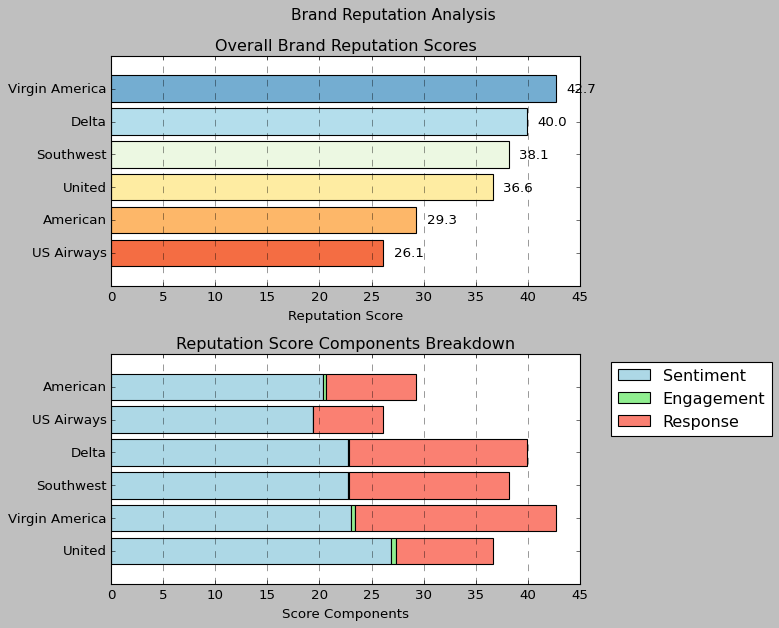

In [109]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def calculate_brand_reputation_score(df):
    reputation_scores = {}
    component_scores = {}
    
    for airline in df['airline'].unique():
        airline_data = df[df['airline'] == airline]
        
        # Calculate components of reputation score
        sentiment_score = airline_data['compound_score'].mean()
        engagement_rate = (airline_data['retweet_count'] / airline_data['retweet_count'].max()).mean()
        response_rate = len(airline_data[airline_data['negativereason'].notna()]) / len(airline_data)
        
        # Store component scores for visualization
        component_scores[airline] = {
            'Sentiment': 0.4 * (sentiment_score + 1) / 2 * 100,
            'Engagement': 0.3 * engagement_rate * 100,
            'Response': 0.3 * (1 - response_rate) * 100
        }
        
        # Combined score (weighted average)
        reputation_score = (
            0.4 * (sentiment_score + 1) / 2 +  # Normalize to 0-1
            0.3 * engagement_rate +
            0.3 * (1 - response_rate)  # Lower response_rate is better
        )
        
        reputation_scores[airline] = reputation_score * 100  # Convert to 0-100 scale
    
    return pd.Series(reputation_scores).round(2), component_scores

def visualize_reputation_scores(reputation_scores, component_scores):
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))
    plt.subplots_adjust(top=0.9)  # Adjust spacing for title
    fig.suptitle('Brand Reputation Analysis', fontsize=14)
    
    # Plot 1: Overall Reputation Scores (Bar Chart)
    sorted_scores = reputation_scores.sort_values(ascending=True)
    colors = plt.cm.RdYlBu(np.linspace(0.2, 0.8, len(sorted_scores)))
    
    bars = ax1.barh(range(len(sorted_scores)), sorted_scores.values, color=colors)
    ax1.set_yticks(range(len(sorted_scores)))
    ax1.set_yticklabels(sorted_scores.index)
    ax1.set_xlabel('Reputation Score')
    ax1.set_title('Overall Brand Reputation Scores')
    ax1.grid(True, axis='x', linestyle='--', alpha=0.7)
    
    # Add value labels on bars
    for i, v in enumerate(sorted_scores.values):
        ax1.text(v + 1, i, f'{v:.1f}', va='center')
    
    # Plot 2: Component Breakdown
    airlines = list(component_scores.keys())
    sentiment = [scores['Sentiment'] for scores in component_scores.values()]
    engagement = [scores['Engagement'] for scores in component_scores.values()]
    response = [scores['Response'] for scores in component_scores.values()]
    
    # Creating stacked bars manually for better control
    width = 0.8
    y_pos = range(len(airlines))
    
    ax2.barh(y_pos, sentiment, width, label='Sentiment', color='lightblue')
    ax2.barh(y_pos, engagement, width, left=sentiment, label='Engagement', color='lightgreen')
    ax2.barh(y_pos, response, width, left=np.array(sentiment) + np.array(engagement), 
             label='Response', color='salmon')
    
    ax2.set_yticks(y_pos)
    ax2.set_yticklabels(airlines)
    ax2.set_xlabel('Score Components')
    ax2.set_title('Reputation Score Components Breakdown')
    ax2.grid(True, axis='x', linestyle='--', alpha=0.7)
    ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Adjust layout
    plt.tight_layout()
    return fig

# Calculate scores and visualize
reputation_scores, component_scores = calculate_brand_reputation_score(combined_df)

# Create and display visualization
fig = visualize_reputation_scores(reputation_scores, component_scores)

# Print numerical results
print("\nBrand Reputation Scores (0-100):")
print(reputation_scores.sort_values(ascending=False))

# Display the plot
plt.show()

In [117]:
def create_brand_radar_chart(benchmark_df):
    metrics = ['sentiment_ratio', 'avg_sentiment_strength', 'engagement_rate']
    
    fig = go.Figure()
    for airline in benchmark_df.index:
        fig.add_trace(go.Scatterpolar(
            r=[benchmark_df.loc[airline, metric] for metric in metrics],
            theta=metrics,
            name=airline
        ))
    
    fig.update_layout(
        polar=dict(radialaxis=dict(visible=True, range=[0, 1])),
        title='Brand Performance Comparison'
    )
    fig.show()

create_brand_radar_chart(benchmark_df)